In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
import h5py
import os
import numpy as np
import pandas as pd
from PIL import Image, ImageOps
import matplotlib.pyplot as plt

data_dir="drive/My Drive/covid-chestxray-dataset-master/images/"
metadata_path="drive/My Drive/covid-chestxray-dataset-master/"
new_dir="drive/My Drive/Coronahack-Chest-XRay-Dataset/Coronahack-Chest-XRay-Dataset/train/"
new_meta_dir="drive/My Drive/Coronahack-Chest-XRay-Dataset/"


In [ ]:
meta_data=pd.read_csv(new_meta_dir+'metadata_processed.csv')
meta_data.groupby(['finding']).agg({'filename':'count'})

,filename
finding,
COVID-19,586
Non Covid,6102


In [ ]:
# selecting only covid ones in x_train
from keras.preprocessing.image import ImageDataGenerator,load_img, img_to_array
from sklearn.model_selection import train_test_split

meta_data = meta_data[meta_data['finding']=='COVID-19']

x_train, x_test, y_train , y_test = train_test_split(meta_data, meta_data['finding'], random_state=42, stratify=meta_data['finding'])
x_train=meta_data
print(x_train.groupby(['finding']).agg({'filename':'count'}))

IMG_H, IMG_W = 64,64
BATCH_SIZE = 32
image_shape = (64,64,3)
epochs=200 

          filename
finding           
COVID-19       586


In [ ]:
def imgdata():
  train_datagen = ImageDataGenerator()

  train_generator = train_datagen.flow_from_dataframe(
      dataframe=x_train, 
      # color_mode='grayscale',
      shuffle=False,
      target_size=(IMG_H, IMG_W),
      batch_size=BATCH_SIZE,
      x_col='filename',
      y_col="finding",
      class_mode=None,
      subset='training',
      directory=new_dir)

  validation_generator = train_datagen.flow_from_dataframe(
  dataframe=x_train, 
      target_size=(IMG_H, IMG_W),
      # color_mode='grayscale',
      shuffle=False,
      batch_size=BATCH_SIZE,
      x_col='filename',
      y_col="finding",
      class_mode="categorical",
      subset='validation',
      directory=new_dir)

  test_generator = train_datagen.flow_from_dataframe(
      dataframe=x_test, 
      # color_mode='grayscale',
      target_size=(IMG_H, IMG_W),
      shuffle=False,
      batch_size=BATCH_SIZE,
      x_col='filename',
      y_col="finding",
      class_mode="categorical",
      directory=new_dir)
  
  return train_generator, test_generator, validation_generator



In [ ]:
from keras.models import Sequential, Model
from keras.layers import Conv2D, Conv2DTranspose, Reshape
from keras.layers import Flatten, BatchNormalization, Dense, Activation, Input, UpSampling2D,MaxPooling2D
from keras.layers.advanced_activations import LeakyReLU
from keras.optimizers import Adam, RMSprop
import time
import os
import matplotlib.pyplot as plt

import matplotlib.gridspec as gridspec

# Creates the discriminator model. This model tries to classify images as real
# or fake.
def construct_discriminator(image_shape):

    input_shape = (64, 64, 3)
    image_input = Input(shape = input_shape)
    conv_1_image = Conv2D(64, (5, 5), padding='same')(image_input)
    act_1_image = Activation('tanh')(conv_1_image)
    pool_1_image = MaxPooling2D(pool_size=(2, 2))(act_1_image)

    conv_2_image = Conv2D(128, (5, 5), padding='same')(pool_1_image)
    act_2_image = Activation('tanh')(conv_2_image)
    pool_2_image = MaxPooling2D(pool_size=(2, 2))(act_2_image)

    # conv_3_image = Conv2D(64, (5, 5), padding='same')(pool_2_image)
    # act_3_image = Activation('tanh')(conv_3_image)
    # pool_3_image = MaxPooling2D(pool_size=(2, 2))(act_3_image)

    flat = Flatten()(pool_2_image)
    dense_1 = Dense(100)(flat)
    act_1 = Activation('tanh')(dense_1)
    dense_2 = Dense(1)(act_1)
    act_2 = Activation('sigmoid')(dense_2)
    model = Model(inputs=[image_input], outputs=act_2)
    optimizer = Adam(learning_rate=0.0001)
    model.compile(loss=wasserstein_loss,
                          optimizer=r_opt,
                          metrics=None)

    return model


# Creates the generator model. This model has an input of random noise and
# generates an image that will try mislead the discriminator.
def construct_generator():

    input_z = Input((100,))
    dense_z_1 = Dense(1024)(input_z)
    act_z_1 = Activation('tanh')(dense_z_1)
    dense_z_2 = Dense(128 * 8 * 8)(act_z_1)
    bn_z_1 = BatchNormalization()(dense_z_2)
    reshape_z = Reshape((8, 8, 128), input_shape=(128 * 8 * 8,))(bn_z_1)

    # Image generation with the concatenated inputs
    conv_1 = Conv2D(32, (5, 5), padding='same')(reshape_z)
    act_1 = Activation('tanh')(conv_1)
    up_1 = UpSampling2D(size=(2, 2))(act_1)

    conv_2 = Conv2D(64, (5, 5), padding='same')(up_1)
    act_2 = Activation('tanh')(conv_2)
    up_2 = UpSampling2D(size=(2, 2))(act_2)

    conv_3 = Conv2D(128, (5, 5), padding='same')(up_2)
    act_3 = Activation('tanh')(conv_3)
    up_3 = UpSampling2D(size=(2, 2))(act_3)

    conv_4 = Conv2D(3, (5, 5), padding='same')(up_3)
    act_4 = Activation("tanh")(conv_4)
    model = Model(inputs=[input_z], outputs=act_4)

    optimizer = Adam(learning_rate=0.0001)
    model.compile(loss=wasserstein_loss,
                      optimizer=r_opt,
                      metrics=None)

    return model

In [ ]:
def save_generated_images(generated_images, epoch, batch_number):

    plt.figure(figsize=(8, 8), num=2)
    gs1 = gridspec.GridSpec(8, 8)
    gs1.update(wspace=0, hspace=0)

    for i in range(32):
        ax1 = plt.subplot(gs1[i])
        ax1.set_aspect('equal')
        image = generated_images[i, :, :, :]
        image += 1
        image *= 127.5
        # image = np.reshape(image, [64, 64])
        # plt.imshow(image, cmap='gray')
        fig = plt.imshow(image.astype(np.uint8), cmap='gray')
        plt.axis('off')
        fig.axes.get_xaxis().set_visible(False)
        fig.axes.get_yaxis().set_visible(False)

    plt.tight_layout()
    save_name = data_dir + 'generatedSamples_epoch' + str(
        epoch + 1) + '_batch' + str(batch_number + 1) + '.png'

    # plt.savefig(save_name, bbox_inches='tight', pad_inches=0)
    plt.pause(0.0000000001)
    plt.show()

In [ ]:
import keras.backend as K
from keras.models import load_model

r_opt = RMSprop(lr=0.00005)
def wasserstein_loss(y_true, y_pred):
        return K.mean(y_true * y_pred)

# Not making new models
generator = construct_generator()
discriminator = construct_discriminator(image_shape)
# generator = load_model(data_dir + 'wgenerator_epoch.hdf5', custom_objects={'wasserstein_loss':wasserstein_loss})
# discriminator = load_model(data_dir + 'wdiscriminator_epoch.hdf5', custom_objects={'wasserstein_loss':wasserstein_loss})


gan = Sequential()
# Only false for the adversarial model
discriminator.trainable = False
gan.add(generator)
gan.add(discriminator)

gan.compile(loss=wasserstein_loss, optimizer=r_opt,
                metrics=None)

print(generator.summary(), discriminator.summary())

Model: "model_2"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_3 (InputLayer)         [(None, 100)]             0         
_________________________________________________________________
dense_4 (Dense)              (None, 1024)              103424    
_________________________________________________________________
activation_9 (Activation)    (None, 1024)              0         
_________________________________________________________________
dense_5 (Dense)              (None, 8192)              8396800   
_________________________________________________________________
batch_normalization_1 (Batch (None, 8192)              32768     
_________________________________________________________________
reshape_1 (Reshape)          (None, 8, 8, 128)         0         
_________________________________________________________________
conv2d_6 (Conv2D)            (None, 8, 8, 32)          1024

In [ ]:
adversarial_loss = np.empty(shape=1)
discriminator_loss = np.empty(shape=1)
batches = np.empty(shape=1)
plt.close()
# train_generator = np.asarray(val_generator)

In [ ]:
train_generator, _, _ = imgdata()

/usr/local/lib/python3.7/dist-packages/keras_preprocessing/image/dataframe_iterator.py:282: UserWarning: Found 49 invalid image filename(s) in x_col="filename". These filename(s) will be ignored.
  .format(n_invalid, x_col)


Found 537 validated image filenames.
Found 0 validated image filenames belonging to 1 classes.
Found 134 validated image filenames belonging to 1 classes.


/usr/local/lib/python3.7/dist-packages/keras_preprocessing/image/dataframe_iterator.py:282: UserWarning: Found 13 invalid image filename(s) in x_col="filename". These filename(s) will be ignored.
  .format(n_invalid, x_col)


Epoch 1/100 :
     Batch 1/9 generator loss | discriminator loss : -0.568067729473114 | 0.0844719409942627 - batch took 8.863644361495972 s.
     Batch 2/9 generator loss | discriminator loss : -0.5041546821594238 | -0.33912110328674316 - batch took 8.223384141921997 s.
     Batch 3/9 generator loss | discriminator loss : -0.32590264081954956 | -0.4581637382507324 - batch took 6.631300926208496 s.
     Batch 4/9 generator loss | discriminator loss : -0.19130359590053558 | -0.5111753344535828 - batch took 7.064643144607544 s.


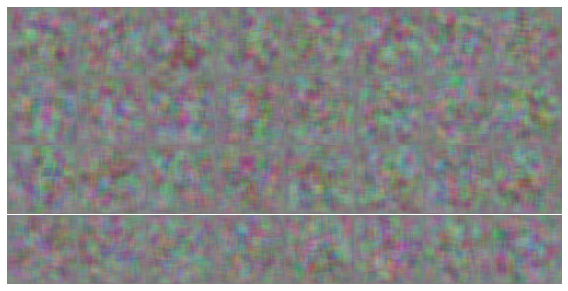

     Batch 5/9 generator loss | discriminator loss : -0.13504263758659363 | 0.11578726768493652 - batch took 9.137709617614746 s.
     Batch 6/9 generator loss | discriminator loss : -0.19012828171253204 | -0.5469829738140106 - batch took 6.709073781967163 s.
     Batch 7/9 generator loss | discriminator loss : -0.1957002431154251 | -0.5432197451591492 - batch took 7.17402720451355 s.
     Batch 8/9 generator loss | discriminator loss : -0.2772980332374573 | -0.5554805994033813 - batch took 7.629919052124023 s.
     Batch 9/9 generator loss | discriminator loss : -0.3639029264450073 | -0.33142441511154175 - batch took 7.011175155639648 s.


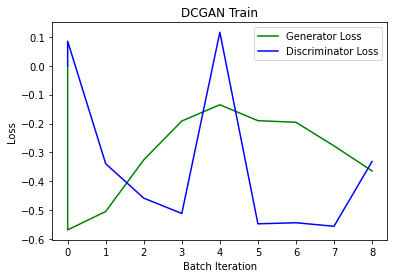

Epoch 2/100 :
     Batch 1/9 generator loss | discriminator loss : -0.4522020220756531 | -0.4991905689239502 - batch took 6.848978281021118 s.
     Batch 2/9 generator loss | discriminator loss : -0.4113246202468872 | -0.5875040292739868 - batch took 7.011145114898682 s.
     Batch 3/9 generator loss | discriminator loss : -0.49604517221450806 | -0.6044069826602936 - batch took 6.33807897567749 s.
     Batch 4/9 generator loss | discriminator loss : -0.343283474445343 | -0.46158838272094727 - batch took 6.574325084686279 s.


<Figure size 432x288 with 0 Axes>

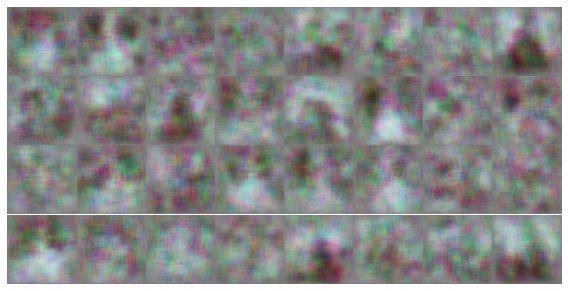

     Batch 5/9 generator loss | discriminator loss : -0.33571550250053406 | 0.15928849577903748 - batch took 8.327534914016724 s.
     Batch 6/9 generator loss | discriminator loss : -0.34839433431625366 | -0.5703976154327393 - batch took 6.494906187057495 s.
     Batch 7/9 generator loss | discriminator loss : -0.4043236970901489 | -0.4717005491256714 - batch took 7.026796340942383 s.
     Batch 8/9 generator loss | discriminator loss : -0.38137561082839966 | -0.3730161786079407 - batch took 6.587465763092041 s.
     Batch 9/9 generator loss | discriminator loss : -0.4104076325893402 | -0.4286232590675354 - batch took 6.965660810470581 s.


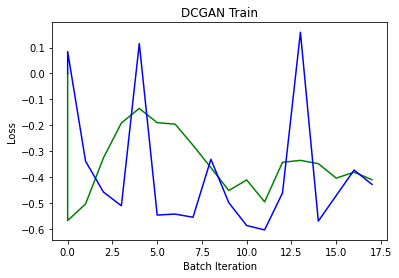

Epoch 3/100 :
     Batch 1/9 generator loss | discriminator loss : -0.42406830191612244 | -0.6094487309455872 - batch took 8.158812522888184 s.
     Batch 2/9 generator loss | discriminator loss : -0.4258251190185547 | -0.5428285300731659 - batch took 6.56381893157959 s.
     Batch 3/9 generator loss | discriminator loss : -0.4115947484970093 | -0.5744680762290955 - batch took 7.026093006134033 s.
     Batch 4/9 generator loss | discriminator loss : -0.4186711013317108 | -0.5143877565860748 - batch took 7.619776010513306 s.


<Figure size 432x288 with 0 Axes>

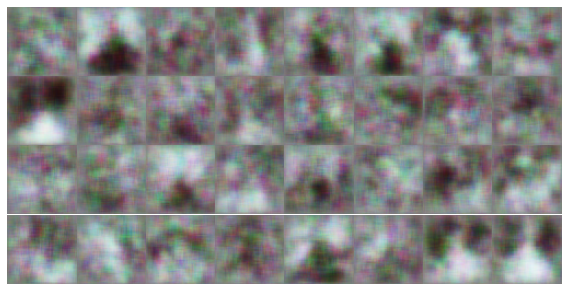

     Batch 5/9 generator loss | discriminator loss : -0.41654929518699646 | 0.15742959082126617 - batch took 7.985894441604614 s.
     Batch 6/9 generator loss | discriminator loss : -0.48494574427604675 | -0.4542243182659149 - batch took 7.227880001068115 s.
     Batch 7/9 generator loss | discriminator loss : -0.3758748173713684 | -0.41448819637298584 - batch took 7.520668268203735 s.
     Batch 8/9 generator loss | discriminator loss : -0.4433954358100891 | -0.08816516399383545 - batch took 7.045682430267334 s.
     Batch 9/9 generator loss | discriminator loss : -0.434716135263443 | -0.2870944142341614 - batch took 6.8393943309783936 s.


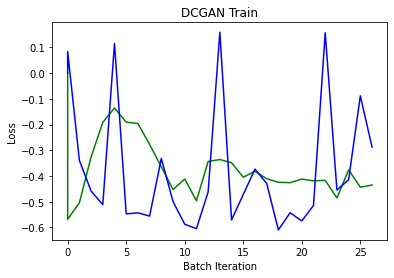

Epoch 4/100 :
     Batch 1/9 generator loss | discriminator loss : -0.44058242440223694 | -0.3645442724227905 - batch took 6.947345733642578 s.
     Batch 2/9 generator loss | discriminator loss : -0.40564072132110596 | -0.40682554244995117 - batch took 6.310698747634888 s.
     Batch 3/9 generator loss | discriminator loss : -0.497227281332016 | -0.44932228326797485 - batch took 6.667038440704346 s.
     Batch 4/9 generator loss | discriminator loss : -0.41972970962524414 | -0.590246170759201 - batch took 6.92984414100647 s.


<Figure size 432x288 with 0 Axes>

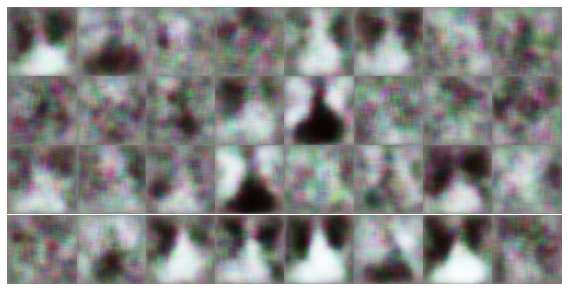

     Batch 5/9 generator loss | discriminator loss : -0.40591317415237427 | 0.2017526626586914 - batch took 7.609668016433716 s.
     Batch 6/9 generator loss | discriminator loss : -0.42532700300216675 | -0.5364043116569519 - batch took 7.101963043212891 s.
     Batch 7/9 generator loss | discriminator loss : -0.4199965000152588 | -0.5170543193817139 - batch took 5.626209020614624 s.
     Batch 8/9 generator loss | discriminator loss : -0.35205450654029846 | -0.39709633588790894 - batch took 6.950960159301758 s.
     Batch 9/9 generator loss | discriminator loss : -0.3899918496608734 | -0.469124436378479 - batch took 8.157661199569702 s.


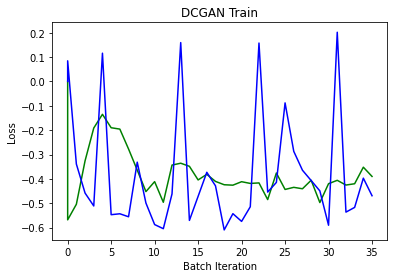

Epoch 5/100 :
     Batch 1/9 generator loss | discriminator loss : -0.36967748403549194 | -0.553834080696106 - batch took 6.55685567855835 s.
     Batch 2/9 generator loss | discriminator loss : -0.42971235513687134 | -0.469585120677948 - batch took 7.081861972808838 s.
     Batch 3/9 generator loss | discriminator loss : -0.36500057578086853 | -0.47803282737731934 - batch took 8.10689902305603 s.
     Batch 4/9 generator loss | discriminator loss : -0.4625350832939148 | -0.5474470555782318 - batch took 6.696502208709717 s.


<Figure size 432x288 with 0 Axes>

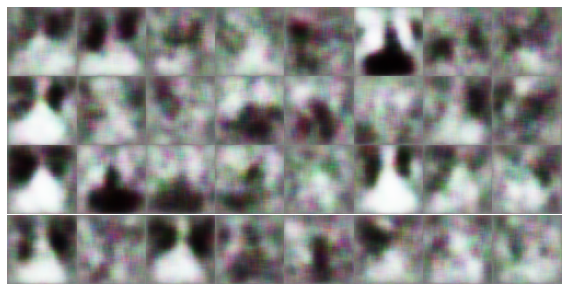

     Batch 5/9 generator loss | discriminator loss : -0.47566622495651245 | 0.25626009702682495 - batch took 9.182104349136353 s.
     Batch 6/9 generator loss | discriminator loss : -0.3894293010234833 | -0.4850981533527374 - batch took 7.584943532943726 s.
     Batch 7/9 generator loss | discriminator loss : -0.345730185508728 | -0.26624244451522827 - batch took 7.629612445831299 s.
     Batch 8/9 generator loss | discriminator loss : -0.4116574823856354 | -0.3750215768814087 - batch took 6.880526781082153 s.
     Batch 9/9 generator loss | discriminator loss : -0.3743548095226288 | -0.32161641120910645 - batch took 7.542885780334473 s.


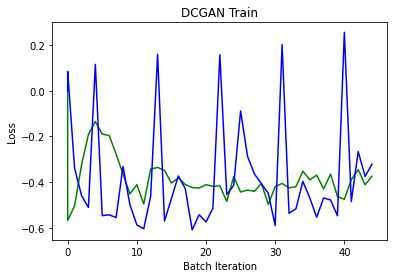

Epoch 6/100 :
     Batch 1/9 generator loss | discriminator loss : -0.44102415442466736 | -0.538650393486023 - batch took 6.469172716140747 s.
     Batch 2/9 generator loss | discriminator loss : -0.44354596734046936 | -0.45963114500045776 - batch took 7.063341856002808 s.
     Batch 3/9 generator loss | discriminator loss : -0.3847615122795105 | -0.4285614490509033 - batch took 6.980393171310425 s.
     Batch 4/9 generator loss | discriminator loss : -0.3927530348300934 | -0.5210441946983337 - batch took 6.423068284988403 s.


<Figure size 432x288 with 0 Axes>

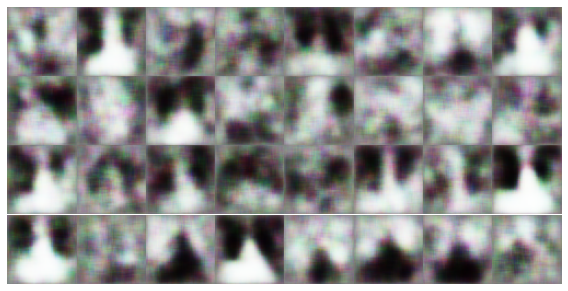

     Batch 5/9 generator loss | discriminator loss : -0.3821427822113037 | 0.20881599187850952 - batch took 8.181178092956543 s.
     Batch 6/9 generator loss | discriminator loss : -0.2795056402683258 | -0.451096773147583 - batch took 5.74005651473999 s.
     Batch 7/9 generator loss | discriminator loss : -0.44793471693992615 | -0.41345492005348206 - batch took 6.964183807373047 s.
     Batch 8/9 generator loss | discriminator loss : -0.32068684697151184 | -0.6562677025794983 - batch took 8.16041350364685 s.
     Batch 9/9 generator loss | discriminator loss : -0.44667279720306396 | -0.4661165475845337 - batch took 6.500420093536377 s.


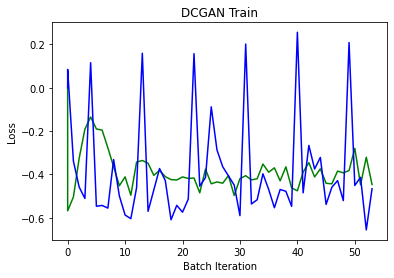

Epoch 7/100 :
     Batch 1/9 generator loss | discriminator loss : -0.3935331106185913 | -0.42980241775512695 - batch took 7.072075843811035 s.
     Batch 2/9 generator loss | discriminator loss : -0.22596341371536255 | -0.6592241525650024 - batch took 7.551416397094727 s.
     Batch 3/9 generator loss | discriminator loss : -0.2749580144882202 | -0.4359714388847351 - batch took 6.616930723190308 s.
     Batch 4/9 generator loss | discriminator loss : -0.40263932943344116 | -0.6373343169689178 - batch took 7.1999194622039795 s.


<Figure size 432x288 with 0 Axes>

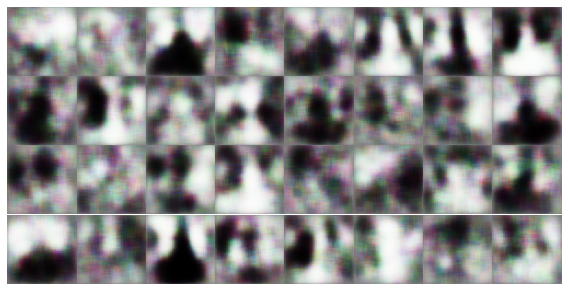

     Batch 5/9 generator loss | discriminator loss : -0.2603885531425476 | 0.16518853604793549 - batch took 9.028489351272583 s.
     Batch 6/9 generator loss | discriminator loss : -0.35627371072769165 | -0.06641364097595215 - batch took 7.142428398132324 s.
     Batch 7/9 generator loss | discriminator loss : -0.3814084529876709 | -0.2205905020236969 - batch took 6.865692853927612 s.
     Batch 8/9 generator loss | discriminator loss : -0.33189502358436584 | -0.6263805031776428 - batch took 6.953471422195435 s.
     Batch 9/9 generator loss | discriminator loss : -0.34773969650268555 | -0.3732755780220032 - batch took 6.35019850730896 s.


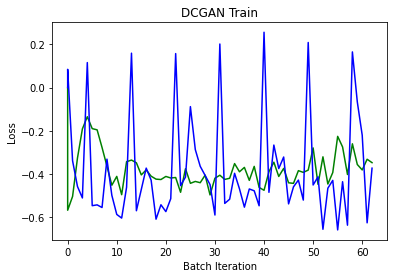

Epoch 8/100 :
     Batch 1/9 generator loss | discriminator loss : -0.2692665457725525 | -0.5819610357284546 - batch took 6.61108660697937 s.
     Batch 2/9 generator loss | discriminator loss : -0.3941059112548828 | -0.3306671380996704 - batch took 7.028087139129639 s.
     Batch 3/9 generator loss | discriminator loss : -0.4412122368812561 | -0.44221651554107666 - batch took 6.430009365081787 s.
     Batch 4/9 generator loss | discriminator loss : -0.39206597208976746 | -0.5101474225521088 - batch took 6.993651390075684 s.
     Batch 5/9 generator loss | discriminator loss : -0.39526599645614624 | 0.24021212756633759 - batch took 5.670355558395386 s.
     Batch 6/9 generator loss | discriminator loss : -0.2542389929294586 | -0.4481605887413025 - batch took 6.959789991378784 s.
     Batch 7/9 generator loss | discriminator loss : -0.3488032817840576 | -0.6141439378261566 - batch took 8.075815677642822 s.
     Batch 8/9 generator loss | discriminator loss : -0.3352983295917511 | -0.632

<Figure size 432x288 with 0 Axes>

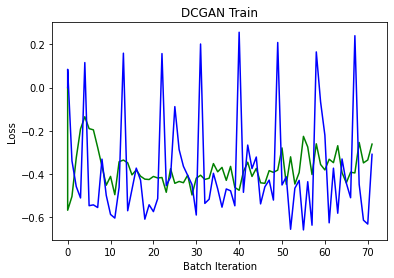

Epoch 9/100 :
     Batch 1/9 generator loss | discriminator loss : -0.3028416037559509 | -0.6654062271118164 - batch took 7.591961860656738 s.
     Batch 2/9 generator loss | discriminator loss : -0.34410911798477173 | -0.47111910581588745 - batch took 6.92399263381958 s.
     Batch 3/9 generator loss | discriminator loss : -0.3705299496650696 | -0.6809267997741699 - batch took 7.201389312744141 s.
     Batch 4/9 generator loss | discriminator loss : -0.25333431363105774 | -0.6432859301567078 - batch took 7.557568073272705 s.


<Figure size 432x288 with 0 Axes>

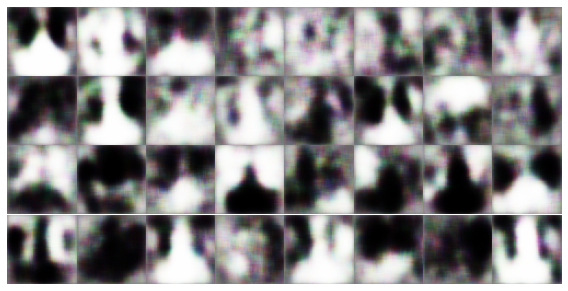

     Batch 5/9 generator loss | discriminator loss : -0.2862037718296051 | 0.11936408281326294 - batch took 8.328895807266235 s.
     Batch 6/9 generator loss | discriminator loss : -0.3245600461959839 | -0.2363097369670868 - batch took 6.96326756477356 s.
     Batch 7/9 generator loss | discriminator loss : -0.2944154739379883 | -0.627671480178833 - batch took 6.9976277351379395 s.
     Batch 8/9 generator loss | discriminator loss : -0.29491180181503296 | -0.513226330280304 - batch took 6.407934904098511 s.
     Batch 9/9 generator loss | discriminator loss : -0.29030731320381165 | -0.6720443964004517 - batch took 6.586500883102417 s.


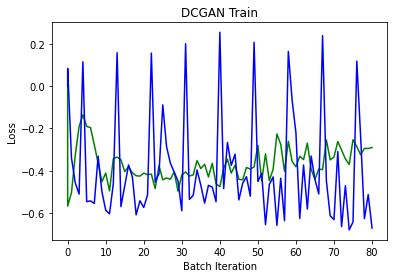

Epoch 10/100 :
     Batch 1/9 generator loss | discriminator loss : -0.22622819244861603 | -0.6053271293640137 - batch took 7.006434679031372 s.
     Batch 2/9 generator loss | discriminator loss : -0.21175721287727356 | -0.4892232418060303 - batch took 6.397496700286865 s.
     Batch 3/9 generator loss | discriminator loss : -0.3533700108528137 | -0.6587032973766327 - batch took 7.44882345199585 s.
     Batch 4/9 generator loss | discriminator loss : -0.21134069561958313 | -0.6135453283786774 - batch took 5.720122337341309 s.


<Figure size 432x288 with 0 Axes>

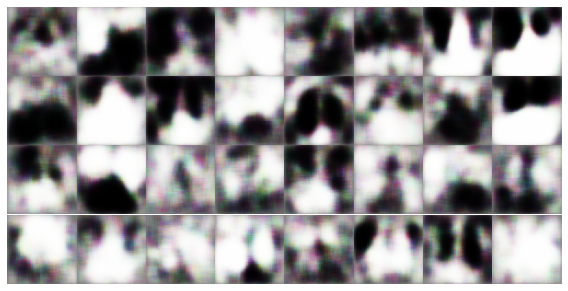

     Batch 5/9 generator loss | discriminator loss : -0.3187604546546936 | -0.050581544637680054 - batch took 8.41676139831543 s.
     Batch 6/9 generator loss | discriminator loss : -0.22110584378242493 | -0.6401704251766205 - batch took 8.236387968063354 s.
     Batch 7/9 generator loss | discriminator loss : -0.4177241623401642 | -0.723675012588501 - batch took 6.993088245391846 s.
     Batch 8/9 generator loss | discriminator loss : -0.2687341272830963 | -0.5885815024375916 - batch took 7.041205644607544 s.
     Batch 9/9 generator loss | discriminator loss : -0.27917709946632385 | -0.743665412068367 - batch took 8.076068878173828 s.


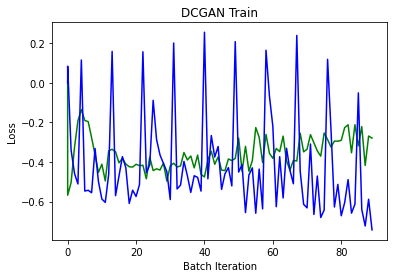

Epoch 11/100 :
     Batch 1/9 generator loss | discriminator loss : -0.3410078287124634 | -0.5454443097114563 - batch took 6.868070602416992 s.
     Batch 2/9 generator loss | discriminator loss : -0.41046205163002014 | -0.4438369870185852 - batch took 7.527611970901489 s.
     Batch 3/9 generator loss | discriminator loss : -0.30455929040908813 | -0.6590314507484436 - batch took 7.527597665786743 s.
     Batch 4/9 generator loss | discriminator loss : -0.3496490716934204 | -0.5084490180015564 - batch took 7.028721809387207 s.


<Figure size 432x288 with 0 Axes>

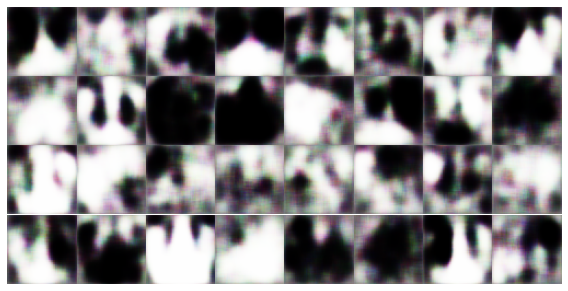

     Batch 5/9 generator loss | discriminator loss : -0.2197413593530655 | 0.17434337735176086 - batch took 7.998968601226807 s.
     Batch 6/9 generator loss | discriminator loss : -0.3510046601295471 | -0.5578584671020508 - batch took 7.011670827865601 s.
     Batch 7/9 generator loss | discriminator loss : -0.2593914568424225 | -0.5752661228179932 - batch took 6.351739883422852 s.
     Batch 8/9 generator loss | discriminator loss : -0.31394410133361816 | -0.6528845131397247 - batch took 6.619547128677368 s.
     Batch 9/9 generator loss | discriminator loss : -0.3293362259864807 | -0.6042264103889465 - batch took 6.969485759735107 s.


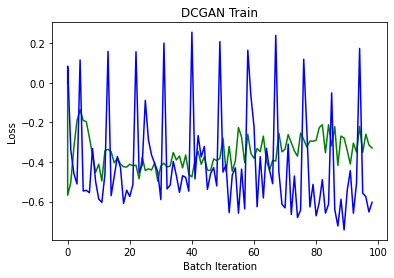

Epoch 12/100 :
     Batch 1/9 generator loss | discriminator loss : -0.37434661388397217 | -0.6307145357131958 - batch took 6.437061548233032 s.
     Batch 2/9 generator loss | discriminator loss : -0.24589833617210388 | -0.5768807828426361 - batch took 6.993244886398315 s.
     Batch 3/9 generator loss | discriminator loss : -0.33246690034866333 | -0.47385352849960327 - batch took 5.705844879150391 s.
     Batch 4/9 generator loss | discriminator loss : -0.2947245240211487 | -0.5616856217384338 - batch took 7.0016701221466064 s.


<Figure size 432x288 with 0 Axes>

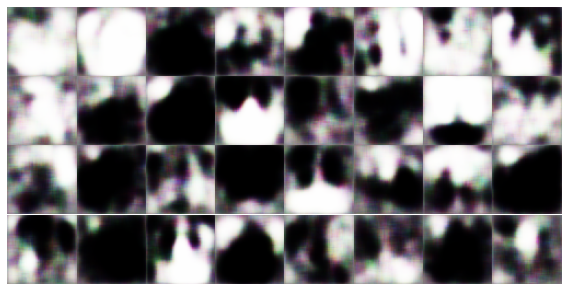

     Batch 5/9 generator loss | discriminator loss : -0.4252369701862335 | 0.041159093379974365 - batch took 9.549344539642334 s.
     Batch 6/9 generator loss | discriminator loss : -0.26871418952941895 | -0.487934947013855 - batch took 6.664731740951538 s.
     Batch 7/9 generator loss | discriminator loss : -0.26497459411621094 | -0.7016962468624115 - batch took 7.060832738876343 s.
     Batch 8/9 generator loss | discriminator loss : -0.18022021651268005 | -0.41566359996795654 - batch took 7.6095311641693115 s.
     Batch 9/9 generator loss | discriminator loss : -0.2464909553527832 | -0.6270807683467865 - batch took 6.674944877624512 s.


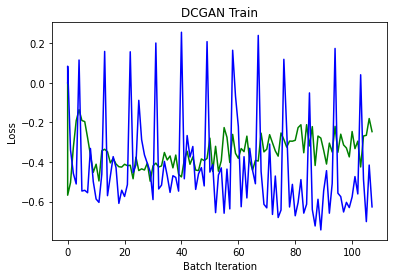

Epoch 13/100 :
     Batch 1/9 generator loss | discriminator loss : -0.350041925907135 | -0.5619548559188843 - batch took 7.235683917999268 s.
     Batch 2/9 generator loss | discriminator loss : -0.33521655201911926 | -0.7802350521087646 - batch took 7.53937840461731 s.
     Batch 3/9 generator loss | discriminator loss : -0.2897118330001831 | -0.4172462821006775 - batch took 7.051077365875244 s.
     Batch 4/9 generator loss | discriminator loss : -0.2831045091152191 | -0.5210523009300232 - batch took 6.855980634689331 s.


<Figure size 432x288 with 0 Axes>

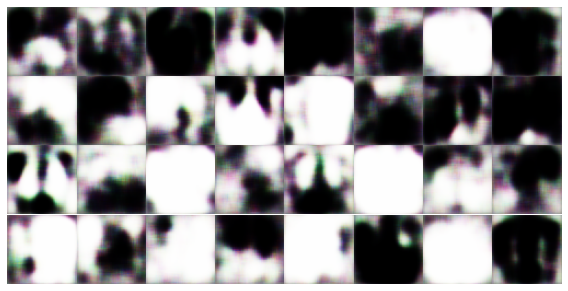

     Batch 5/9 generator loss | discriminator loss : -0.2975641191005707 | 0.011282891035079956 - batch took 8.308901309967041 s.
     Batch 6/9 generator loss | discriminator loss : -0.31102800369262695 | -0.6673709750175476 - batch took 6.414945125579834 s.
     Batch 7/9 generator loss | discriminator loss : -0.34126466512680054 | -0.5190410614013672 - batch took 6.632797718048096 s.
     Batch 8/9 generator loss | discriminator loss : -0.3416585922241211 | -0.6103562414646149 - batch took 6.950619459152222 s.
     Batch 9/9 generator loss | discriminator loss : -0.2710643708705902 | -0.579064667224884 - batch took 6.443995475769043 s.


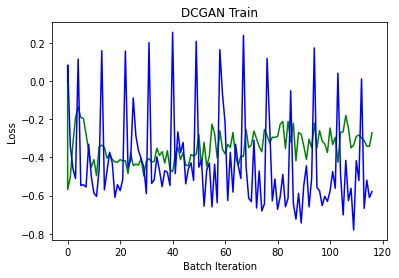

Epoch 14/100 :
     Batch 1/9 generator loss | discriminator loss : -0.33234816789627075 | -0.72286057472229 - batch took 7.081896543502808 s.
     Batch 2/9 generator loss | discriminator loss : -0.3851683437824249 | -0.560228705406189 - batch took 5.674037218093872 s.
     Batch 3/9 generator loss | discriminator loss : -0.3020715117454529 | -0.6407905220985413 - batch took 6.948744058609009 s.
     Batch 4/9 generator loss | discriminator loss : -0.35695987939834595 | -0.5656552612781525 - batch took 8.134373664855957 s.


<Figure size 432x288 with 0 Axes>

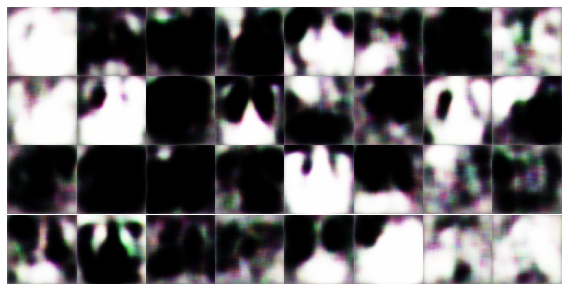

     Batch 5/9 generator loss | discriminator loss : -0.3130953907966614 | 0.0775219202041626 - batch took 7.685413122177124 s.
     Batch 6/9 generator loss | discriminator loss : -0.32084646821022034 | -0.7675002664327621 - batch took 7.123117208480835 s.
     Batch 7/9 generator loss | discriminator loss : -0.2898072898387909 | -0.742883637547493 - batch took 7.6066062450408936 s.
     Batch 8/9 generator loss | discriminator loss : -0.2612870931625366 | -0.5273697674274445 - batch took 6.670281887054443 s.
     Batch 9/9 generator loss | discriminator loss : -0.29796648025512695 | -0.5994383990764618 - batch took 7.212630271911621 s.


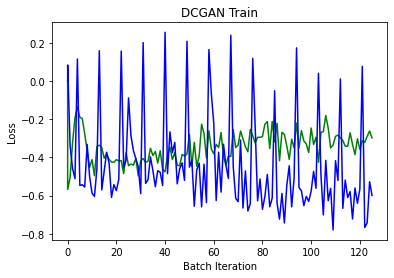

Epoch 15/100 :
     Batch 1/9 generator loss | discriminator loss : -0.16560427844524384 | -0.667066752910614 - batch took 7.614953517913818 s.
     Batch 2/9 generator loss | discriminator loss : -0.29340410232543945 | -0.5776916742324829 - batch took 7.087209701538086 s.
     Batch 3/9 generator loss | discriminator loss : -0.27744626998901367 | -0.7277689129114151 - batch took 7.36481237411499 s.
     Batch 4/9 generator loss | discriminator loss : -0.23574738204479218 | -0.7296451926231384 - batch took 7.133984565734863 s.


<Figure size 432x288 with 0 Axes>

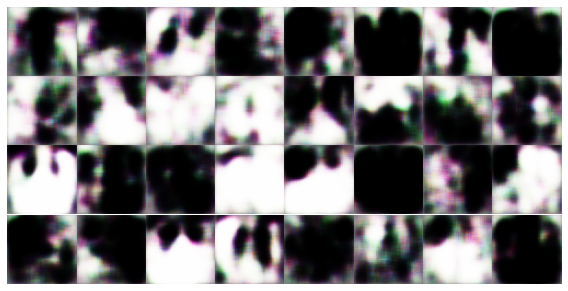

     Batch 5/9 generator loss | discriminator loss : -0.24105143547058105 | -0.11945775151252747 - batch took 8.457330703735352 s.
     Batch 6/9 generator loss | discriminator loss : -0.26948514580726624 | -0.549726665019989 - batch took 6.779226303100586 s.
     Batch 7/9 generator loss | discriminator loss : -0.39713048934936523 | -0.6184161901473999 - batch took 7.4444990158081055 s.
     Batch 8/9 generator loss | discriminator loss : -0.31220144033432007 | -0.3742203414440155 - batch took 6.4418957233428955 s.
     Batch 9/9 generator loss | discriminator loss : -0.2437039315700531 | -0.7277980893850327 - batch took 7.885046005249023 s.


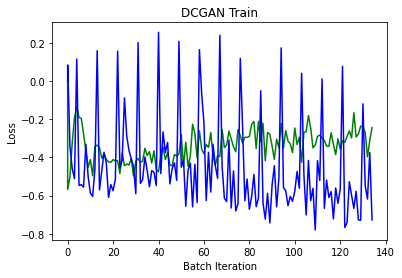

Epoch 16/100 :
     Batch 1/9 generator loss | discriminator loss : -0.27127110958099365 | -0.7659306824207306 - batch took 5.815251350402832 s.
     Batch 2/9 generator loss | discriminator loss : -0.27346283197402954 | -0.7616793066263199 - batch took 7.409183979034424 s.
     Batch 3/9 generator loss | discriminator loss : -0.2815549075603485 | -0.7008534818887711 - batch took 8.197962760925293 s.
     Batch 4/9 generator loss | discriminator loss : -0.25807324051856995 | -0.7289986908435822 - batch took 6.582506418228149 s.


<Figure size 432x288 with 0 Axes>

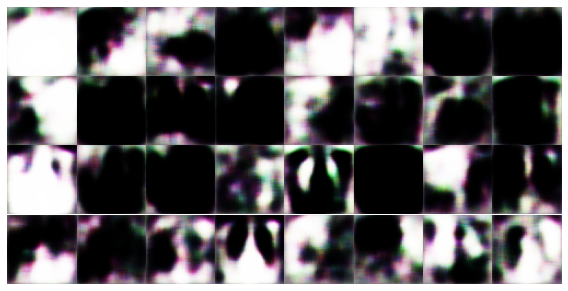

     Batch 5/9 generator loss | discriminator loss : -0.2523626685142517 | -0.017479345202445984 - batch took 8.211576223373413 s.
     Batch 6/9 generator loss | discriminator loss : -0.26595550775527954 | -0.617987871170044 - batch took 7.655046224594116 s.
     Batch 7/9 generator loss | discriminator loss : -0.2859380841255188 | -0.6288770437240601 - batch took 6.691663503646851 s.
     Batch 8/9 generator loss | discriminator loss : -0.23212912678718567 | -0.4987390786409378 - batch took 7.226001501083374 s.
     Batch 9/9 generator loss | discriminator loss : -0.16179415583610535 | -0.7651003748178482 - batch took 7.599766731262207 s.


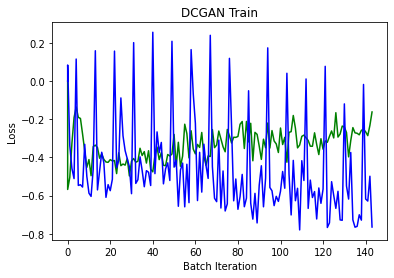

Epoch 17/100 :
     Batch 1/9 generator loss | discriminator loss : -0.14604882895946503 | -0.7532155215740204 - batch took 7.119496822357178 s.
     Batch 2/9 generator loss | discriminator loss : -0.23526161909103394 | -0.809291809797287 - batch took 6.914397954940796 s.
     Batch 3/9 generator loss | discriminator loss : -0.23597382009029388 | -0.6595615148544312 - batch took 6.96466326713562 s.
     Batch 4/9 generator loss | discriminator loss : -0.27811649441719055 | -0.6951715350151062 - batch took 6.363370895385742 s.


<Figure size 432x288 with 0 Axes>

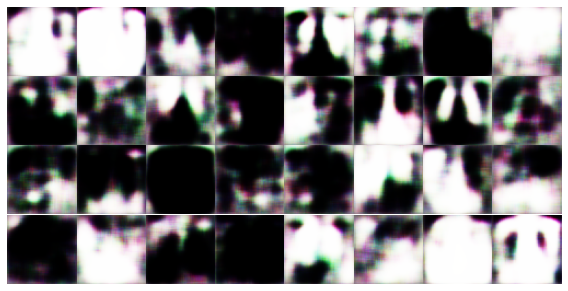

     Batch 5/9 generator loss | discriminator loss : -0.2504527270793915 | 0.00042006373405456543 - batch took 8.012513160705566 s.
     Batch 6/9 generator loss | discriminator loss : -0.1808413714170456 | -0.6941999793052673 - batch took 7.06754994392395 s.
     Batch 7/9 generator loss | discriminator loss : -0.2923508286476135 | -0.639659970998764 - batch took 6.405966758728027 s.
     Batch 8/9 generator loss | discriminator loss : -0.24943724274635315 | -0.7619803547859192 - batch took 7.037630558013916 s.
     Batch 9/9 generator loss | discriminator loss : -0.22261202335357666 | -0.7137915045022964 - batch took 5.656676292419434 s.


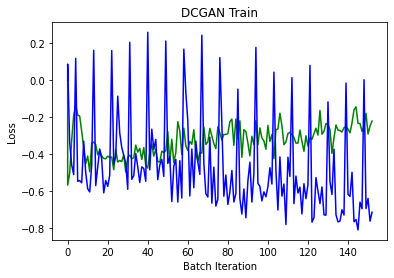

Epoch 18/100 :
     Batch 1/9 generator loss | discriminator loss : -0.21804234385490417 | -0.6802943348884583 - batch took 7.002292156219482 s.
     Batch 2/9 generator loss | discriminator loss : -0.25546973943710327 | -0.5415164828300476 - batch took 8.173548221588135 s.
     Batch 3/9 generator loss | discriminator loss : -0.30847156047821045 | -0.6252210140228271 - batch took 6.591877222061157 s.
     Batch 4/9 generator loss | discriminator loss : -0.1427687108516693 | -0.6405509114265442 - batch took 7.062018394470215 s.


<Figure size 432x288 with 0 Axes>

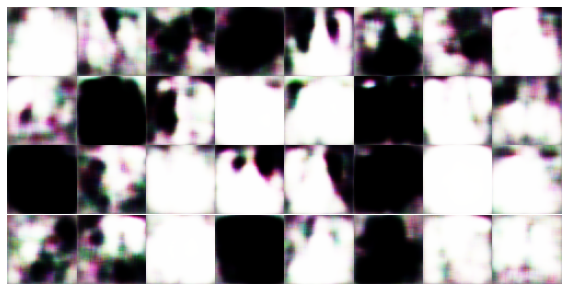

     Batch 5/9 generator loss | discriminator loss : -0.3785235285758972 | 0.0009321123361587524 - batch took 8.896973133087158 s.
     Batch 6/9 generator loss | discriminator loss : -0.16991592943668365 | -0.6079024374485016 - batch took 6.814178466796875 s.
     Batch 7/9 generator loss | discriminator loss : -0.059766221791505814 | -0.6760037541389465 - batch took 7.246901035308838 s.
     Batch 8/9 generator loss | discriminator loss : -0.21922343969345093 | -0.8541753888130188 - batch took 7.572427272796631 s.
     Batch 9/9 generator loss | discriminator loss : -0.1758279800415039 | -0.7980106174945831 - batch took 7.000900506973267 s.


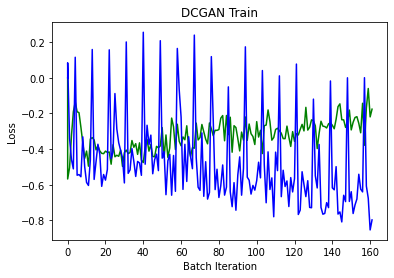

Epoch 19/100 :
     Batch 1/9 generator loss | discriminator loss : -0.16726595163345337 | -0.8954636380076408 - batch took 6.946299076080322 s.
     Batch 2/9 generator loss | discriminator loss : -0.3588169813156128 | -0.8752720877528191 - batch took 6.975044012069702 s.
     Batch 3/9 generator loss | discriminator loss : -0.24823249876499176 | -0.672624945640564 - batch took 6.375516653060913 s.
     Batch 4/9 generator loss | discriminator loss : -0.2892991006374359 | -0.7887822389602661 - batch took 6.591357946395874 s.


<Figure size 432x288 with 0 Axes>

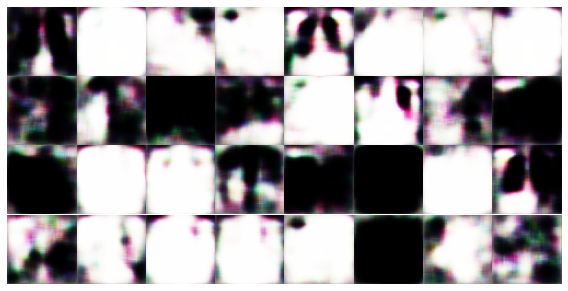

     Batch 5/9 generator loss | discriminator loss : -0.2345304638147354 | 0.12846216559410095 - batch took 8.338157176971436 s.
     Batch 6/9 generator loss | discriminator loss : -0.4203186631202698 | -0.6366877257823944 - batch took 6.457229375839233 s.
     Batch 7/9 generator loss | discriminator loss : -0.37032872438430786 | -0.5910311341285706 - batch took 7.058844327926636 s.
     Batch 8/9 generator loss | discriminator loss : -0.3944827616214752 | -0.7657837122678757 - batch took 5.6425793170928955 s.
     Batch 9/9 generator loss | discriminator loss : -0.25910842418670654 | -0.5934126973152161 - batch took 6.969682455062866 s.


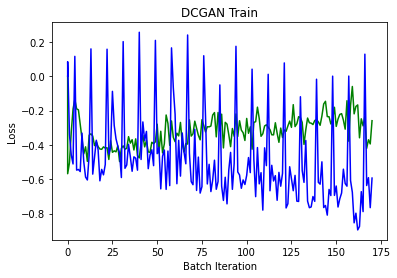

Epoch 20/100 :
     Batch 1/9 generator loss | discriminator loss : -0.19531922042369843 | -0.8007459342479706 - batch took 8.189221858978271 s.
     Batch 2/9 generator loss | discriminator loss : -0.36873212456703186 | -0.7437944710254669 - batch took 6.808608055114746 s.
     Batch 3/9 generator loss | discriminator loss : -0.27921125292778015 | -0.6465488374233246 - batch took 7.616492033004761 s.
     Batch 4/9 generator loss | discriminator loss : -0.09577205032110214 | -0.6377789080142975 - batch took 7.718422889709473 s.


<Figure size 432x288 with 0 Axes>

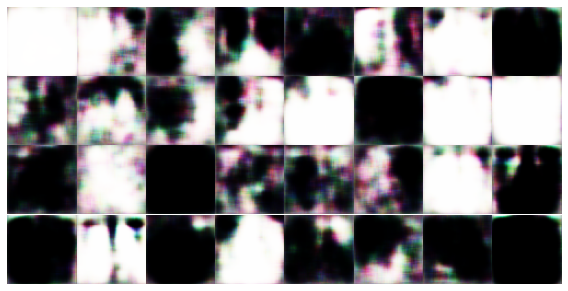

     Batch 5/9 generator loss | discriminator loss : -0.09547355771064758 | -0.14885571599006653 - batch took 8.418411493301392 s.
     Batch 6/9 generator loss | discriminator loss : -0.3073142170906067 | -0.6675516664981842 - batch took 7.26647162437439 s.
     Batch 7/9 generator loss | discriminator loss : -0.31648504734039307 | -0.6337825059890747 - batch took 8.13591194152832 s.
     Batch 8/9 generator loss | discriminator loss : -0.1444549411535263 | -0.669430285692215 - batch took 7.064021825790405 s.
     Batch 9/9 generator loss | discriminator loss : -0.2711511254310608 | -0.8095977455377579 - batch took 7.450968980789185 s.


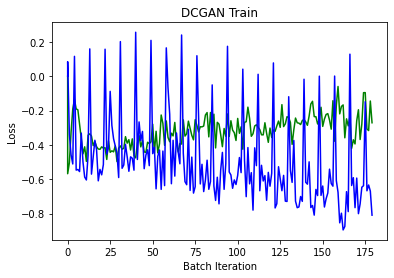

Epoch 21/100 :
     Batch 1/9 generator loss | discriminator loss : -0.05045121908187866 | -0.6947407722473145 - batch took 7.023820638656616 s.
     Batch 2/9 generator loss | discriminator loss : -0.10285668075084686 | -0.7839189320802689 - batch took 6.7389817237854 s.
     Batch 3/9 generator loss | discriminator loss : -0.03511866554617882 | -0.7979705929756165 - batch took 6.640579700469971 s.
     Batch 4/9 generator loss | discriminator loss : -0.19188159704208374 | -0.7794530391693115 - batch took 6.992685794830322 s.


<Figure size 432x288 with 0 Axes>

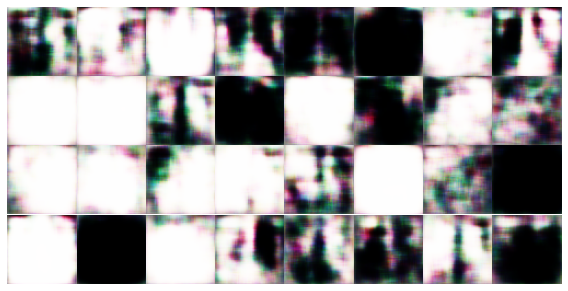

     Batch 5/9 generator loss | discriminator loss : -0.36053112149238586 | -0.03965950012207031 - batch took 8.56680679321289 s.
     Batch 6/9 generator loss | discriminator loss : -0.32438182830810547 | -0.6366348713636398 - batch took 7.140530347824097 s.
     Batch 7/9 generator loss | discriminator loss : -0.23287199437618256 | -0.4972107708454132 - batch took 5.690914630889893 s.
     Batch 8/9 generator loss | discriminator loss : -0.10199664533138275 | -0.7469380348920822 - batch took 6.957636117935181 s.
     Batch 9/9 generator loss | discriminator loss : -0.13134855031967163 | -0.760778933763504 - batch took 8.148199796676636 s.


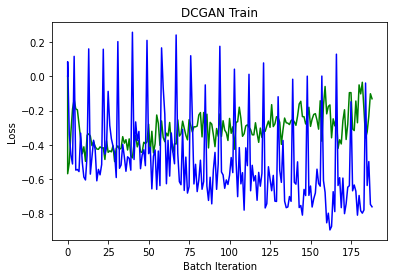

Epoch 22/100 :
     Batch 1/9 generator loss | discriminator loss : -0.22292324900627136 | -0.8159566223621368 - batch took 6.63396143913269 s.
     Batch 2/9 generator loss | discriminator loss : -0.2906032204627991 | -0.6822829246520996 - batch took 7.065829038619995 s.
     Batch 3/9 generator loss | discriminator loss : -0.20627295970916748 | -0.5331541299819946 - batch took 7.6142213344573975 s.
     Batch 4/9 generator loss | discriminator loss : -0.15814676880836487 | -0.6935461312532425 - batch took 6.689117431640625 s.


<Figure size 432x288 with 0 Axes>

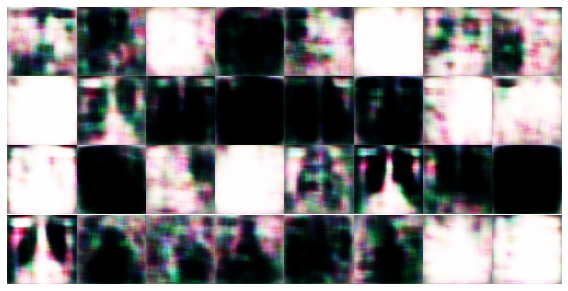

     Batch 5/9 generator loss | discriminator loss : -0.10066130757331848 | -0.0547650009393692 - batch took 8.37450098991394 s.
     Batch 6/9 generator loss | discriminator loss : -0.17722009122371674 | -0.8305729478597641 - batch took 7.66109299659729 s.
     Batch 7/9 generator loss | discriminator loss : -0.17184147238731384 | -0.7018140554428101 - batch took 7.083621263504028 s.
     Batch 8/9 generator loss | discriminator loss : -0.0794534832239151 | -0.824873261153698 - batch took 6.921712160110474 s.
     Batch 9/9 generator loss | discriminator loss : -0.23085321485996246 | -0.7987906634807587 - batch took 6.977178573608398 s.


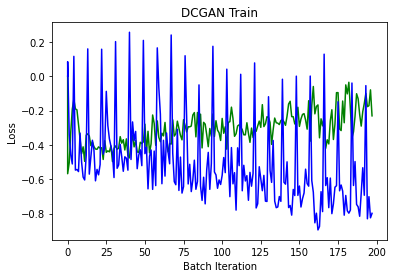

Epoch 23/100 :
     Batch 1/9 generator loss | discriminator loss : -0.1113738864660263 | -0.6503518223762512 - batch took 6.472587585449219 s.
     Batch 2/9 generator loss | discriminator loss : -0.3234468996524811 | -0.738488107919693 - batch took 6.603089332580566 s.
     Batch 3/9 generator loss | discriminator loss : -0.23071976006031036 | -0.596388578414917 - batch took 6.988253831863403 s.
     Batch 4/9 generator loss | discriminator loss : -0.18826858699321747 | -0.678584948182106 - batch took 6.423262596130371 s.


<Figure size 432x288 with 0 Axes>

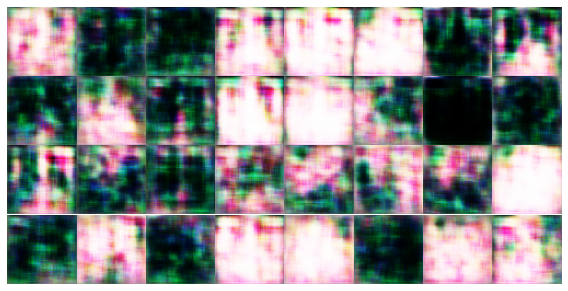

     Batch 5/9 generator loss | discriminator loss : -0.2386384904384613 | 0.007750272750854492 - batch took 8.47696852684021 s.
     Batch 6/9 generator loss | discriminator loss : -0.10310394316911697 | -0.7502221018075943 - batch took 5.893984794616699 s.
     Batch 7/9 generator loss | discriminator loss : -0.2315133512020111 | -0.7134076058864594 - batch took 6.987879276275635 s.
     Batch 8/9 generator loss | discriminator loss : -0.2425328940153122 | -0.5041286945343018 - batch took 8.173846006393433 s.
     Batch 9/9 generator loss | discriminator loss : -0.267728716135025 | -0.5713074803352356 - batch took 6.5706377029418945 s.


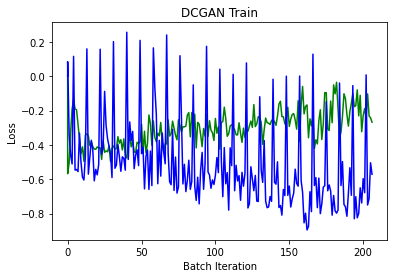

Epoch 24/100 :
     Batch 1/9 generator loss | discriminator loss : -0.16437125205993652 | -0.4884369373321533 - batch took 7.1747496128082275 s.
     Batch 2/9 generator loss | discriminator loss : -0.17009849846363068 | -0.5948017239570618 - batch took 7.622474670410156 s.
     Batch 3/9 generator loss | discriminator loss : -0.21050792932510376 | -0.6495716124773026 - batch took 6.698461532592773 s.
     Batch 4/9 generator loss | discriminator loss : -0.2867250144481659 | -0.4900215268135071 - batch took 7.252533912658691 s.


<Figure size 432x288 with 0 Axes>

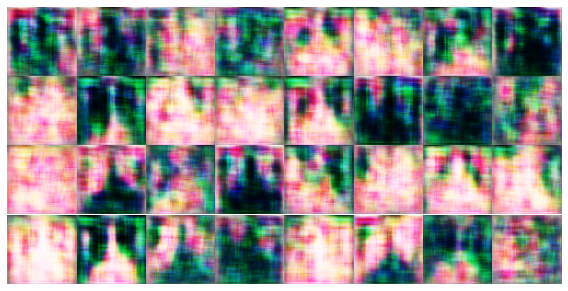

     Batch 5/9 generator loss | discriminator loss : -0.20840555429458618 | 0.006005808711051941 - batch took 8.922671794891357 s.
     Batch 6/9 generator loss | discriminator loss : -0.23331135511398315 | -0.2856217324733734 - batch took 7.198380470275879 s.
     Batch 7/9 generator loss | discriminator loss : -0.33055102825164795 | -0.5412862598896027 - batch took 6.845844984054565 s.
     Batch 8/9 generator loss | discriminator loss : -0.26721709966659546 | -0.5176335573196411 - batch took 7.024564266204834 s.
     Batch 9/9 generator loss | discriminator loss : -0.27924367785453796 | -0.5747821629047394 - batch took 6.403138875961304 s.


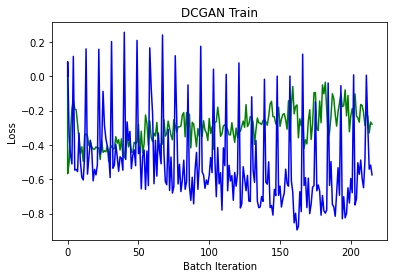

Epoch 25/100 :
     Batch 1/9 generator loss | discriminator loss : -0.12861545383930206 | -0.6376479864120483 - batch took 6.691632986068726 s.
     Batch 2/9 generator loss | discriminator loss : -0.1834179162979126 | -0.685099869966507 - batch took 7.007690906524658 s.
     Batch 3/9 generator loss | discriminator loss : -0.14648893475532532 | -0.520156979560852 - batch took 6.801982402801514 s.
     Batch 4/9 generator loss | discriminator loss : -0.20982588827610016 | -0.6165324449539185 - batch took 7.142505884170532 s.
     Batch 5/9 generator loss | discriminator loss : -0.1323777437210083 | -0.012798771262168884 - batch took 5.72722053527832 s.
     Batch 6/9 generator loss | discriminator loss : -0.2217620462179184 | -0.5201412439346313 - batch took 7.493118047714233 s.
     Batch 7/9 generator loss | discriminator loss : -0.1978720724582672 | -0.5051358640193939 - batch took 8.097191333770752 s.
     Batch 8/9 generator loss | discriminator loss : -0.2540235221385956 | -0.53

<Figure size 432x288 with 0 Axes>

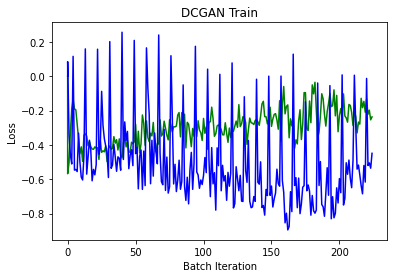

Epoch 26/100 :
     Batch 1/9 generator loss | discriminator loss : -0.2047128975391388 | -0.7140781134366989 - batch took 7.684606313705444 s.
     Batch 2/9 generator loss | discriminator loss : -0.17426125705242157 | -0.6744324266910553 - batch took 7.321992874145508 s.
     Batch 3/9 generator loss | discriminator loss : -0.16492818295955658 | -0.5182376503944397 - batch took 7.1877281665802 s.
     Batch 4/9 generator loss | discriminator loss : -0.21876677870750427 | -0.5629351437091827 - batch took 7.554659843444824 s.


<Figure size 432x288 with 0 Axes>

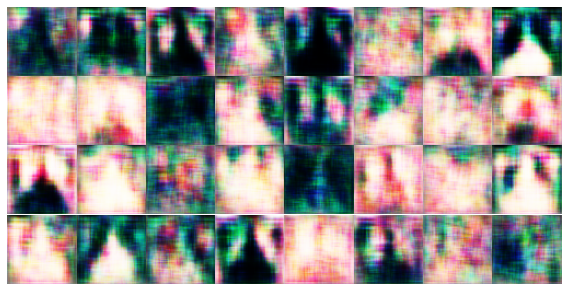

     Batch 5/9 generator loss | discriminator loss : -0.12662242352962494 | 0.014433681964874268 - batch took 8.452455759048462 s.
     Batch 6/9 generator loss | discriminator loss : -0.20263971388339996 | -0.49370360374450684 - batch took 6.9065563678741455 s.
     Batch 7/9 generator loss | discriminator loss : -0.3620510995388031 | -0.5326915681362152 - batch took 6.954720973968506 s.
     Batch 8/9 generator loss | discriminator loss : -0.3279433250427246 | -0.6125602722167969 - batch took 6.447131395339966 s.
     Batch 9/9 generator loss | discriminator loss : -0.31371358036994934 | -0.488488107919693 - batch took 6.604115962982178 s.


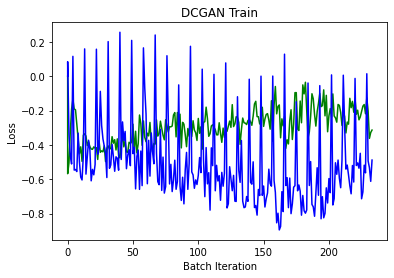

Epoch 27/100 :
     Batch 1/9 generator loss | discriminator loss : -0.2353346049785614 | -0.6091351807117462 - batch took 7.034729719161987 s.
     Batch 2/9 generator loss | discriminator loss : -0.3574041724205017 | -0.3569376468658447 - batch took 6.420507431030273 s.
     Batch 3/9 generator loss | discriminator loss : -0.33230873942375183 | -0.5415645837783813 - batch took 7.009137392044067 s.
     Batch 4/9 generator loss | discriminator loss : -0.19893914461135864 | -0.3193743824958801 - batch took 5.6695778369903564 s.


<Figure size 432x288 with 0 Axes>

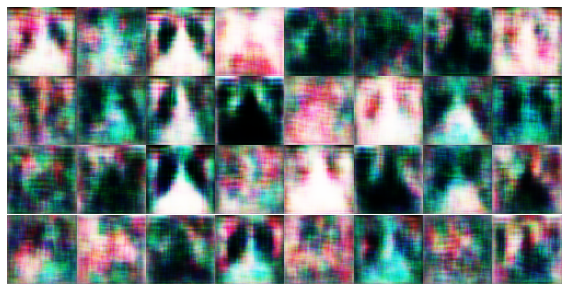

     Batch 5/9 generator loss | discriminator loss : -0.10679690539836884 | 0.08430379629135132 - batch took 8.177900075912476 s.
     Batch 6/9 generator loss | discriminator loss : -0.2647673785686493 | -0.2667515277862549 - batch took 8.219734191894531 s.
     Batch 7/9 generator loss | discriminator loss : -0.23833337426185608 | -0.521439790725708 - batch took 6.5746989250183105 s.
     Batch 8/9 generator loss | discriminator loss : -0.4041869044303894 | -0.4346050024032593 - batch took 7.060176849365234 s.
     Batch 9/9 generator loss | discriminator loss : -0.27866131067276 | -0.5905061960220337 - batch took 7.650095462799072 s.


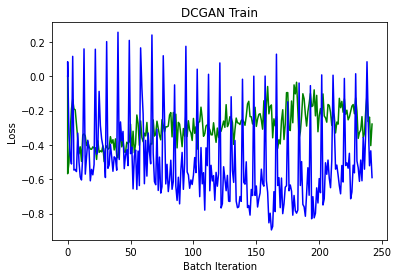

Epoch 28/100 :
     Batch 1/9 generator loss | discriminator loss : -0.31956571340560913 | -0.5605190992355347 - batch took 6.855684280395508 s.
     Batch 2/9 generator loss | discriminator loss : -0.30878835916519165 | -0.38406580686569214 - batch took 7.216427326202393 s.
     Batch 3/9 generator loss | discriminator loss : -0.24912621080875397 | -0.4043528735637665 - batch took 7.60247015953064 s.
     Batch 4/9 generator loss | discriminator loss : -0.29581958055496216 | -0.36954933404922485 - batch took 7.622399568557739 s.


<Figure size 432x288 with 0 Axes>

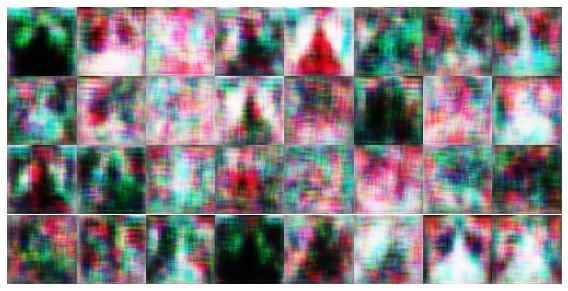

     Batch 5/9 generator loss | discriminator loss : -0.30415451526641846 | 0.04729239642620087 - batch took 8.3488028049469 s.
     Batch 6/9 generator loss | discriminator loss : -0.3277164697647095 | -0.3898361027240753 - batch took 7.199195623397827 s.
     Batch 7/9 generator loss | discriminator loss : -0.42019394040107727 | -0.5112810432910919 - batch took 6.404917240142822 s.
     Batch 8/9 generator loss | discriminator loss : -0.386316180229187 | -0.485598623752594 - batch took 6.625701427459717 s.
     Batch 9/9 generator loss | discriminator loss : -0.3268519341945648 | -0.42190462350845337 - batch took 6.965574026107788 s.


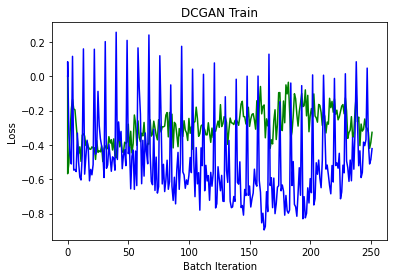

Epoch 29/100 :
     Batch 1/9 generator loss | discriminator loss : -0.372367799282074 | -0.5065588355064392 - batch took 6.520482063293457 s.
     Batch 2/9 generator loss | discriminator loss : -0.3173622488975525 | -0.4419189989566803 - batch took 7.653959035873413 s.
     Batch 3/9 generator loss | discriminator loss : -0.2903975248336792 | -0.5142593383789062 - batch took 5.7796008586883545 s.
     Batch 4/9 generator loss | discriminator loss : -0.35040178894996643 | -0.5393136739730835 - batch took 7.018843650817871 s.


<Figure size 432x288 with 0 Axes>

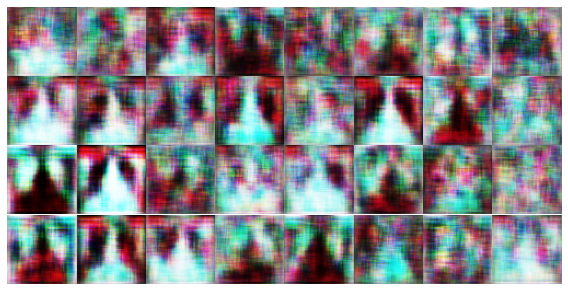

     Batch 5/9 generator loss | discriminator loss : -0.3277762532234192 | 0.17470240592956543 - batch took 9.382595300674438 s.
     Batch 6/9 generator loss | discriminator loss : -0.3604748845100403 | -0.5452752113342285 - batch took 6.82424521446228 s.
     Batch 7/9 generator loss | discriminator loss : -0.2750506103038788 | -0.5866742730140686 - batch took 7.097933292388916 s.
     Batch 8/9 generator loss | discriminator loss : -0.3768497705459595 | -0.6437286734580994 - batch took 7.651998043060303 s.
     Batch 9/9 generator loss | discriminator loss : -0.35996556282043457 | -0.641403466463089 - batch took 6.713582992553711 s.


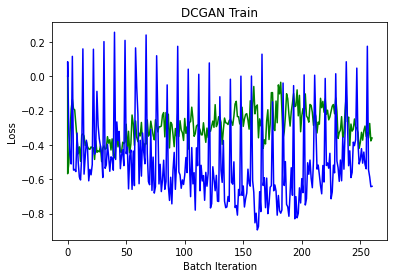

Epoch 30/100 :
     Batch 1/9 generator loss | discriminator loss : -0.3543795347213745 | -0.5529444813728333 - batch took 7.361488342285156 s.
     Batch 2/9 generator loss | discriminator loss : -0.4265251159667969 | -0.47137948870658875 - batch took 7.596864700317383 s.
     Batch 3/9 generator loss | discriminator loss : -0.43901121616363525 | -0.35923850536346436 - batch took 7.662211179733276 s.
     Batch 4/9 generator loss | discriminator loss : -0.4472918212413788 | -0.5338305234909058 - batch took 7.34992527961731 s.


<Figure size 432x288 with 0 Axes>

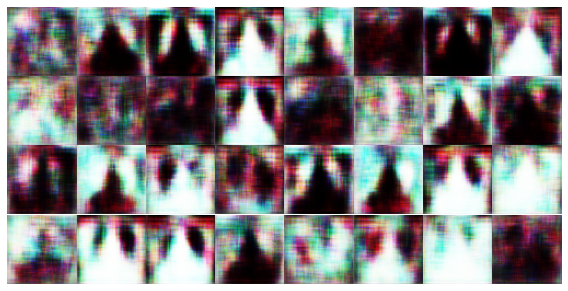

     Batch 5/9 generator loss | discriminator loss : -0.339862585067749 | 0.10281571745872498 - batch took 8.501574516296387 s.
     Batch 6/9 generator loss | discriminator loss : -0.33273109793663025 | -0.5160468220710754 - batch took 6.6327385902404785 s.
     Batch 7/9 generator loss | discriminator loss : -0.3110025227069855 | -0.5739020705223083 - batch took 6.721965789794922 s.
     Batch 8/9 generator loss | discriminator loss : -0.260643869638443 | -0.6445792317390442 - batch took 7.4931793212890625 s.
     Batch 9/9 generator loss | discriminator loss : -0.37759190797805786 | -0.3749766945838928 - batch took 6.91511344909668 s.


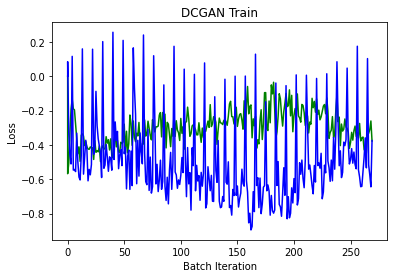

Epoch 31/100 :
     Batch 1/9 generator loss | discriminator loss : -0.44836318492889404 | -0.5400707423686981 - batch took 7.2309746742248535 s.
     Batch 2/9 generator loss | discriminator loss : -0.3937632441520691 | -0.486114501953125 - batch took 5.900712013244629 s.
     Batch 3/9 generator loss | discriminator loss : -0.39597827196121216 | -0.41910427808761597 - batch took 7.2700419425964355 s.
     Batch 4/9 generator loss | discriminator loss : -0.45272940397262573 | -0.4673563241958618 - batch took 8.233560800552368 s.


<Figure size 432x288 with 0 Axes>

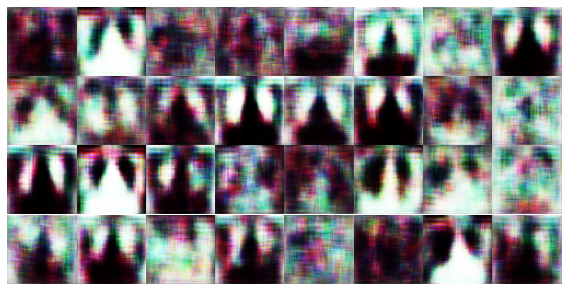

     Batch 5/9 generator loss | discriminator loss : -0.41850101947784424 | 0.024759262800216675 - batch took 7.970199823379517 s.
     Batch 6/9 generator loss | discriminator loss : -0.45153653621673584 | -0.6090552508831024 - batch took 7.269114971160889 s.
     Batch 7/9 generator loss | discriminator loss : -0.42157766222953796 | -0.503061830997467 - batch took 7.702908277511597 s.
     Batch 8/9 generator loss | discriminator loss : -0.4446524977684021 | -0.5444009304046631 - batch took 6.7432403564453125 s.
     Batch 9/9 generator loss | discriminator loss : -0.4051293432712555 | -0.6105274856090546 - batch took 7.244913101196289 s.


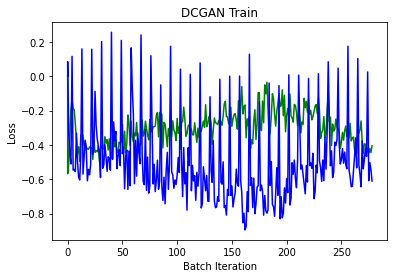

Epoch 32/100 :
     Batch 1/9 generator loss | discriminator loss : -0.4930962920188904 | -0.548112690448761 - batch took 7.72200345993042 s.
     Batch 2/9 generator loss | discriminator loss : -0.4646511673927307 | -0.38891226053237915 - batch took 7.056718826293945 s.
     Batch 3/9 generator loss | discriminator loss : -0.5138900876045227 | -0.37759560346603394 - batch took 6.955726385116577 s.
     Batch 4/9 generator loss | discriminator loss : -0.4727066159248352 | -0.5807853043079376 - batch took 6.998009443283081 s.


<Figure size 432x288 with 0 Axes>

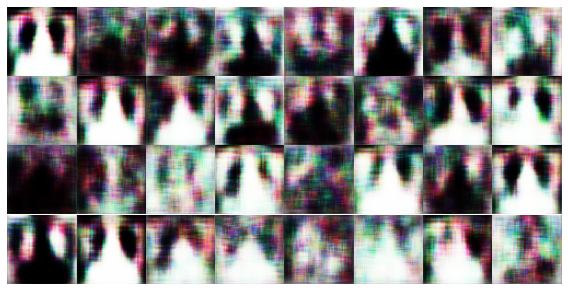

     Batch 5/9 generator loss | discriminator loss : -0.5116438865661621 | 0.22099432349205017 - batch took 7.810149192810059 s.
     Batch 6/9 generator loss | discriminator loss : -0.4059654176235199 | -0.7182109951972961 - batch took 6.7888853549957275 s.
     Batch 7/9 generator loss | discriminator loss : -0.4203042984008789 | -0.5225111842155457 - batch took 7.036459445953369 s.
     Batch 8/9 generator loss | discriminator loss : -0.429262638092041 | -0.4706050157546997 - batch took 6.410804271697998 s.
     Batch 9/9 generator loss | discriminator loss : -0.32649603486061096 | -0.5956002771854401 - batch took 7.120644569396973 s.


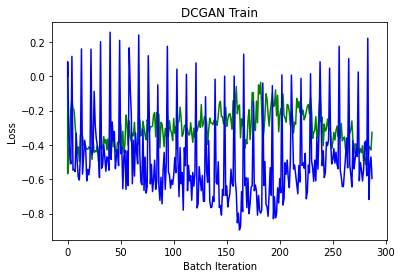

Epoch 33/100 :
     Batch 1/9 generator loss | discriminator loss : -0.33675381541252136 | -0.6777923703193665 - batch took 5.828691244125366 s.
     Batch 2/9 generator loss | discriminator loss : -0.45856747031211853 | -0.5196827054023743 - batch took 6.988448619842529 s.
     Batch 3/9 generator loss | discriminator loss : -0.39975327253341675 | -0.554535984992981 - batch took 8.207895040512085 s.
     Batch 4/9 generator loss | discriminator loss : -0.4748043417930603 | -0.4889436364173889 - batch took 6.647790431976318 s.


<Figure size 432x288 with 0 Axes>

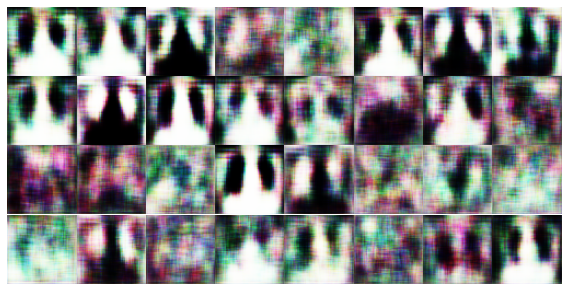

     Batch 5/9 generator loss | discriminator loss : -0.3964608311653137 | 0.15521419048309326 - batch took 8.277261018753052 s.
     Batch 6/9 generator loss | discriminator loss : -0.39066892862319946 | -0.45029300451278687 - batch took 7.8263328075408936 s.
     Batch 7/9 generator loss | discriminator loss : -0.39066004753112793 | -0.37670284509658813 - batch took 6.807576417922974 s.
     Batch 8/9 generator loss | discriminator loss : -0.5182508230209351 | -0.6050807237625122 - batch took 7.28746485710144 s.
     Batch 9/9 generator loss | discriminator loss : -0.439972847700119 | -0.5481526851654053 - batch took 7.620951175689697 s.


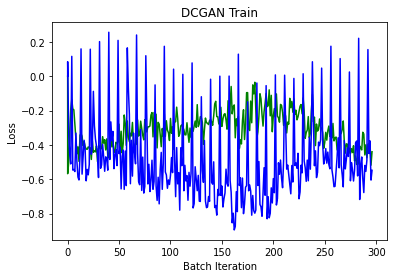

Epoch 34/100 :
     Batch 1/9 generator loss | discriminator loss : -0.3820905089378357 | -0.37143903970718384 - batch took 7.218652009963989 s.
     Batch 2/9 generator loss | discriminator loss : -0.4654308557510376 | -0.425927996635437 - batch took 6.869066953659058 s.
     Batch 3/9 generator loss | discriminator loss : -0.4584749937057495 | -0.5094562768936157 - batch took 7.066911935806274 s.
     Batch 4/9 generator loss | discriminator loss : -0.38969430327415466 | -0.5107769966125488 - batch took 6.42113995552063 s.


<Figure size 432x288 with 0 Axes>

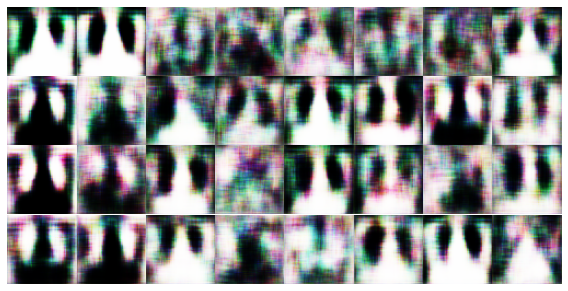

     Batch 5/9 generator loss | discriminator loss : -0.4670407176017761 | 0.2255384922027588 - batch took 8.119594812393188 s.
     Batch 6/9 generator loss | discriminator loss : -0.4906144142150879 | -0.648900717496872 - batch took 7.197610855102539 s.
     Batch 7/9 generator loss | discriminator loss : -0.45387059450149536 | -0.4608917236328125 - batch took 6.441717147827148 s.
     Batch 8/9 generator loss | discriminator loss : -0.42796534299850464 | -0.6366449296474457 - batch took 7.191661834716797 s.
     Batch 9/9 generator loss | discriminator loss : -0.5178827047348022 | -0.37569761276245117 - batch took 5.7694010734558105 s.


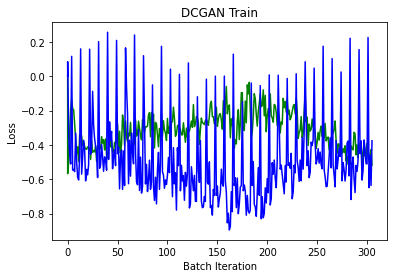

Epoch 35/100 :
     Batch 1/9 generator loss | discriminator loss : -0.39476582407951355 | -0.547829270362854 - batch took 7.206875562667847 s.
     Batch 2/9 generator loss | discriminator loss : -0.5334533452987671 | -0.4483869671821594 - batch took 8.197336196899414 s.
     Batch 3/9 generator loss | discriminator loss : -0.38037818670272827 | -0.5004995763301849 - batch took 6.616966009140015 s.
     Batch 4/9 generator loss | discriminator loss : -0.4415592849254608 | -0.4732832908630371 - batch took 7.135643720626831 s.


<Figure size 432x288 with 0 Axes>

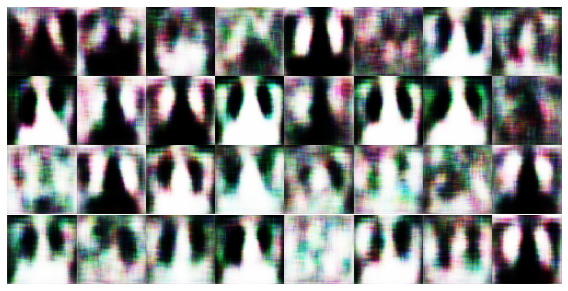

     Batch 5/9 generator loss | discriminator loss : -0.4352262318134308 | 0.24176712334156036 - batch took 8.903528690338135 s.
     Batch 6/9 generator loss | discriminator loss : -0.4406745135784149 | -0.4473264217376709 - batch took 7.144327402114868 s.
     Batch 7/9 generator loss | discriminator loss : -0.500740647315979 | -0.45383647084236145 - batch took 7.569000959396362 s.
     Batch 8/9 generator loss | discriminator loss : -0.45301559567451477 | -0.4802536368370056 - batch took 14.065995216369629 s.
     Batch 9/9 generator loss | discriminator loss : -0.4652255177497864 | -0.35172635316848755 - batch took 7.178018093109131 s.


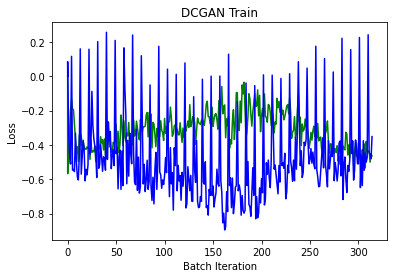

Epoch 36/100 :
     Batch 1/9 generator loss | discriminator loss : -0.5279302597045898 | -0.45518404245376587 - batch took 7.52669095993042 s.
     Batch 2/9 generator loss | discriminator loss : -0.5177558660507202 | -0.5577301979064941 - batch took 7.060009002685547 s.
     Batch 3/9 generator loss | discriminator loss : -0.44326841831207275 | -0.562641829252243 - batch took 6.457250595092773 s.
     Batch 4/9 generator loss | discriminator loss : -0.37567639350891113 | -0.5769990086555481 - batch took 6.643946886062622 s.


<Figure size 432x288 with 0 Axes>

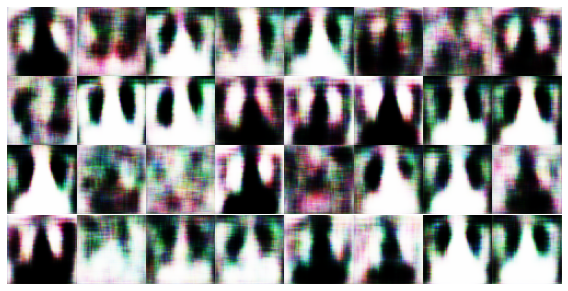

     Batch 5/9 generator loss | discriminator loss : -0.4590417742729187 | 0.20704883337020874 - batch took 8.536505460739136 s.
     Batch 6/9 generator loss | discriminator loss : -0.46316713094711304 | -0.5620414614677429 - batch took 6.667987108230591 s.
     Batch 7/9 generator loss | discriminator loss : -0.4449784457683563 | -0.553192138671875 - batch took 7.11785888671875 s.
     Batch 8/9 generator loss | discriminator loss : -0.4323030114173889 | -0.6157298386096954 - batch took 5.802072048187256 s.
     Batch 9/9 generator loss | discriminator loss : -0.4689237177371979 | -0.6776975393295288 - batch took 7.044361591339111 s.


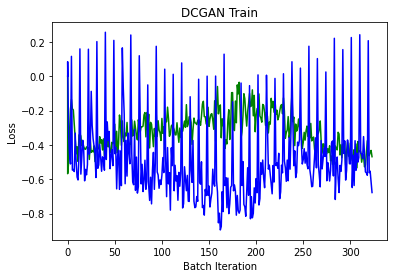

Epoch 37/100 :
     Batch 1/9 generator loss | discriminator loss : -0.3921244144439697 | -0.6258769631385803 - batch took 8.39278793334961 s.
     Batch 2/9 generator loss | discriminator loss : -0.45133456587791443 | -0.3887220025062561 - batch took 6.635517120361328 s.
     Batch 3/9 generator loss | discriminator loss : -0.42627382278442383 | -0.5661199986934662 - batch took 7.144304990768433 s.
     Batch 4/9 generator loss | discriminator loss : -0.433184951543808 | -0.49357879161834717 - batch took 7.713104486465454 s.


<Figure size 432x288 with 0 Axes>

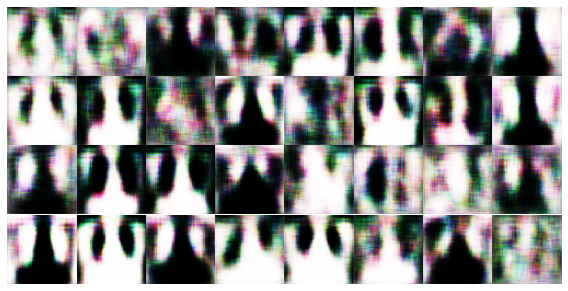

     Batch 5/9 generator loss | discriminator loss : -0.4566819965839386 | 0.22320494055747986 - batch took 8.052121877670288 s.
     Batch 6/9 generator loss | discriminator loss : -0.3743857741355896 | -0.5111663937568665 - batch took 7.443745136260986 s.
     Batch 7/9 generator loss | discriminator loss : -0.4008704423904419 | -0.4700007438659668 - batch took 7.611485719680786 s.
     Batch 8/9 generator loss | discriminator loss : -0.40099000930786133 | -0.364139199256897 - batch took 7.1490209102630615 s.
     Batch 9/9 generator loss | discriminator loss : -0.4701855778694153 | -0.4323989748954773 - batch took 6.938896179199219 s.


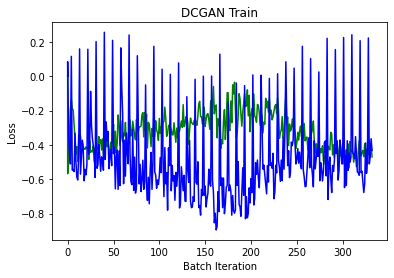

Epoch 38/100 :
     Batch 1/9 generator loss | discriminator loss : -0.4426649212837219 | -0.41017818450927734 - batch took 7.202122449874878 s.
     Batch 2/9 generator loss | discriminator loss : -0.45713740587234497 | -0.5633009672164917 - batch took 6.449713230133057 s.
     Batch 3/9 generator loss | discriminator loss : -0.5082807540893555 | -0.37449026107788086 - batch took 6.698669910430908 s.
     Batch 4/9 generator loss | discriminator loss : -0.40375620126724243 | -0.6300845742225647 - batch took 7.075831174850464 s.


<Figure size 432x288 with 0 Axes>

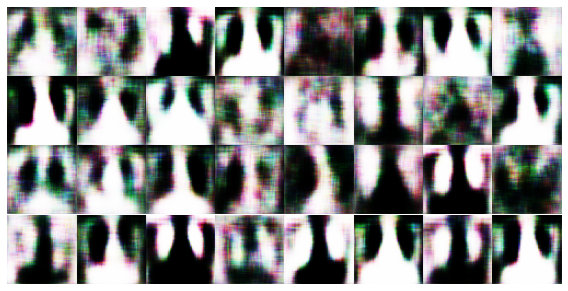

     Batch 5/9 generator loss | discriminator loss : -0.4963946044445038 | 0.23547741770744324 - batch took 7.8687052726745605 s.
     Batch 6/9 generator loss | discriminator loss : -0.4725900888442993 | -0.5741823315620422 - batch took 7.283040523529053 s.
     Batch 7/9 generator loss | discriminator loss : -0.47483181953430176 | -0.5877199769020081 - batch took 5.708124876022339 s.
     Batch 8/9 generator loss | discriminator loss : -0.4056854248046875 | -0.4488571286201477 - batch took 7.021357774734497 s.
     Batch 9/9 generator loss | discriminator loss : -0.4992990493774414 | -0.5341845154762268 - batch took 8.267006397247314 s.


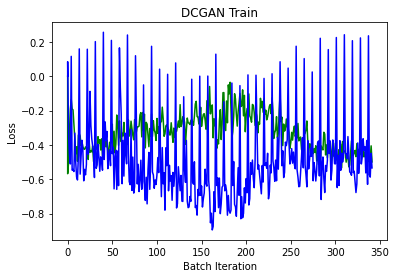

Epoch 39/100 :
     Batch 1/9 generator loss | discriminator loss : -0.5229015350341797 | -0.5836981534957886 - batch took 6.818610429763794 s.
     Batch 2/9 generator loss | discriminator loss : -0.4046705961227417 | -0.24171888828277588 - batch took 7.105783939361572 s.
     Batch 3/9 generator loss | discriminator loss : -0.4019568860530853 | -0.5880339443683624 - batch took 7.657005786895752 s.
     Batch 4/9 generator loss | discriminator loss : -0.46486571431159973 | -0.27073395252227783 - batch took 6.776729106903076 s.


<Figure size 432x288 with 0 Axes>

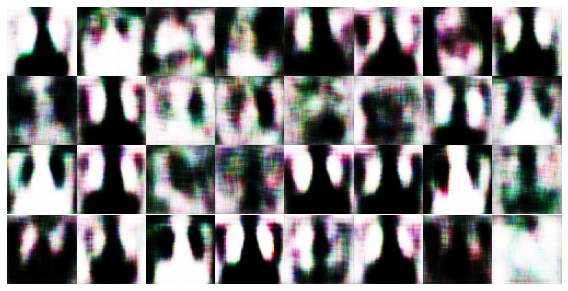

     Batch 5/9 generator loss | discriminator loss : -0.4390923082828522 | 0.05211012065410614 - batch took 8.490602254867554 s.
     Batch 6/9 generator loss | discriminator loss : -0.4849545359611511 | -0.3772895336151123 - batch took 7.865323543548584 s.
     Batch 7/9 generator loss | discriminator loss : -0.5224904417991638 | -0.32708340883255005 - batch took 7.069326400756836 s.
     Batch 8/9 generator loss | discriminator loss : -0.45876607298851013 | -0.4337503910064697 - batch took 6.93431544303894 s.
     Batch 9/9 generator loss | discriminator loss : -0.38447093963623047 | -0.47559303045272827 - batch took 7.031708717346191 s.


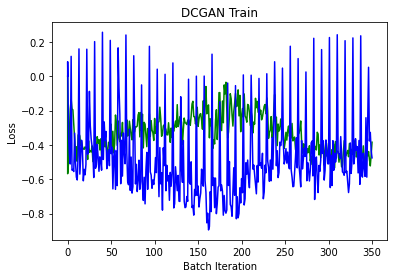

Epoch 40/100 :
     Batch 1/9 generator loss | discriminator loss : -0.4290267527103424 | -0.5917318761348724 - batch took 6.582853078842163 s.
     Batch 2/9 generator loss | discriminator loss : -0.41713160276412964 | -0.3835754990577698 - batch took 6.727937936782837 s.
     Batch 3/9 generator loss | discriminator loss : -0.3721942603588104 | -0.5284213125705719 - batch took 7.517991304397583 s.
     Batch 4/9 generator loss | discriminator loss : -0.5252715349197388 | -0.6194372773170471 - batch took 6.570892572402954 s.


<Figure size 432x288 with 0 Axes>

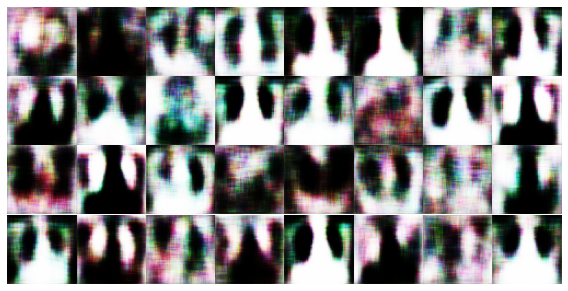

     Batch 5/9 generator loss | discriminator loss : -0.3379366397857666 | 0.2679469734430313 - batch took 9.184577465057373 s.
     Batch 6/9 generator loss | discriminator loss : -0.4598610997200012 | -0.5576746165752411 - batch took 5.757950782775879 s.
     Batch 7/9 generator loss | discriminator loss : -0.42042553424835205 | -0.3447999358177185 - batch took 7.167229175567627 s.
     Batch 8/9 generator loss | discriminator loss : -0.48176270723342896 | -0.6794654428958893 - batch took 8.688249349594116 s.
     Batch 9/9 generator loss | discriminator loss : -0.42805200815200806 | -0.46235179901123047 - batch took 6.592409372329712 s.


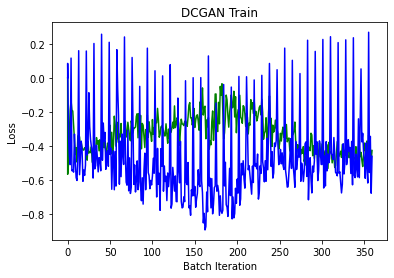

Epoch 41/100 :
     Batch 1/9 generator loss | discriminator loss : -0.5465988516807556 | -0.42204150557518005 - batch took 7.708503723144531 s.
     Batch 2/9 generator loss | discriminator loss : -0.404746413230896 | -0.6658275127410889 - batch took 7.747366428375244 s.
     Batch 3/9 generator loss | discriminator loss : -0.4191313087940216 | -0.46453213691711426 - batch took 6.769493818283081 s.
     Batch 4/9 generator loss | discriminator loss : -0.4670011103153229 | -0.4599981904029846 - batch took 7.297417640686035 s.


<Figure size 432x288 with 0 Axes>

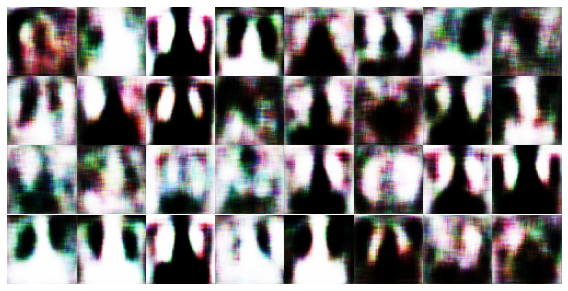

     Batch 5/9 generator loss | discriminator loss : -0.4822276830673218 | 0.059605956077575684 - batch took 8.799001932144165 s.
     Batch 6/9 generator loss | discriminator loss : -0.37584948539733887 | -0.33074378967285156 - batch took 7.332261085510254 s.
     Batch 7/9 generator loss | discriminator loss : -0.4865598678588867 | -0.41332918405532837 - batch took 6.875039339065552 s.
     Batch 8/9 generator loss | discriminator loss : -0.4758020043373108 | -0.4774833917617798 - batch took 7.040622234344482 s.
     Batch 9/9 generator loss | discriminator loss : -0.42342641949653625 | -0.504000723361969 - batch took 6.425777196884155 s.


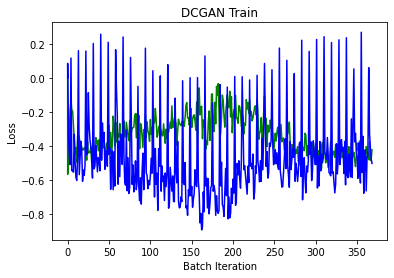

Epoch 42/100 :
     Batch 1/9 generator loss | discriminator loss : -0.38180238008499146 | -0.5707964301109314 - batch took 6.847978353500366 s.
     Batch 2/9 generator loss | discriminator loss : -0.5404407978057861 | -0.6273403763771057 - batch took 7.0502893924713135 s.
     Batch 3/9 generator loss | discriminator loss : -0.45567256212234497 | -0.36724698543548584 - batch took 6.508611440658569 s.
     Batch 4/9 generator loss | discriminator loss : -0.5159804821014404 | -0.5011332631111145 - batch took 7.123795986175537 s.
     Batch 5/9 generator loss | discriminator loss : -0.440418541431427 | 0.171379953622818 - batch took 5.758859157562256 s.
     Batch 6/9 generator loss | discriminator loss : -0.48690494894981384 | -0.4475376009941101 - batch took 7.071208715438843 s.
     Batch 7/9 generator loss | discriminator loss : -0.4510990381240845 | -0.5800199806690216 - batch took 8.236243724822998 s.
     Batch 8/9 generator loss | discriminator loss : -0.36112117767333984 | -0.4

<Figure size 432x288 with 0 Axes>

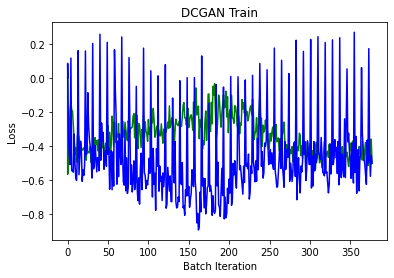

Epoch 43/100 :
     Batch 1/9 generator loss | discriminator loss : -0.5013782978057861 | -0.5385814607143402 - batch took 8.035579919815063 s.
     Batch 2/9 generator loss | discriminator loss : -0.45467013120651245 | -0.5888319611549377 - batch took 6.727539539337158 s.
     Batch 3/9 generator loss | discriminator loss : -0.47095584869384766 | -0.43019551038742065 - batch took 7.316911935806274 s.
     Batch 4/9 generator loss | discriminator loss : -0.46795815229415894 | -0.6705666780471802 - batch took 7.620744943618774 s.


<Figure size 432x288 with 0 Axes>

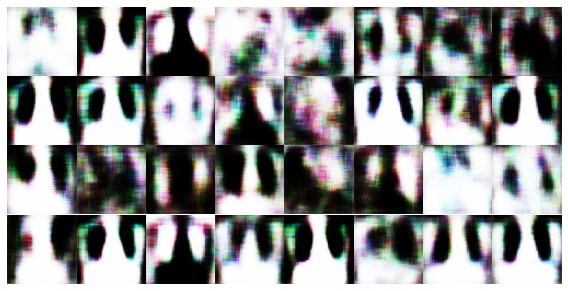

     Batch 5/9 generator loss | discriminator loss : -0.3714695870876312 | 0.31102263927459717 - batch took 8.326616048812866 s.
     Batch 6/9 generator loss | discriminator loss : -0.37408560514450073 | -0.4707988500595093 - batch took 7.112016916275024 s.
     Batch 7/9 generator loss | discriminator loss : -0.3766847252845764 | -0.45983052253723145 - batch took 7.0833611488342285 s.
     Batch 8/9 generator loss | discriminator loss : -0.4102790057659149 | -0.537591278553009 - batch took 6.417664527893066 s.
     Batch 9/9 generator loss | discriminator loss : -0.3205319941043854 | -0.6382578015327454 - batch took 6.743623495101929 s.


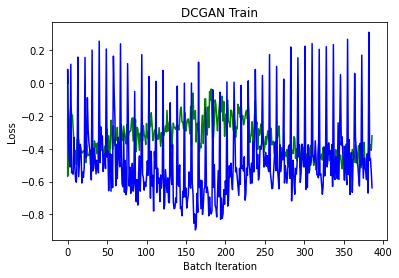

Epoch 44/100 :
     Batch 1/9 generator loss | discriminator loss : -0.526324450969696 | -0.4696800708770752 - batch took 7.259721040725708 s.
     Batch 2/9 generator loss | discriminator loss : -0.4852660894393921 | -0.46510154008865356 - batch took 6.441999435424805 s.
     Batch 3/9 generator loss | discriminator loss : -0.4271579682826996 | -0.6725850105285645 - batch took 7.100585699081421 s.
     Batch 4/9 generator loss | discriminator loss : -0.43449172377586365 | -0.566312313079834 - batch took 5.734331369400024 s.


<Figure size 432x288 with 0 Axes>

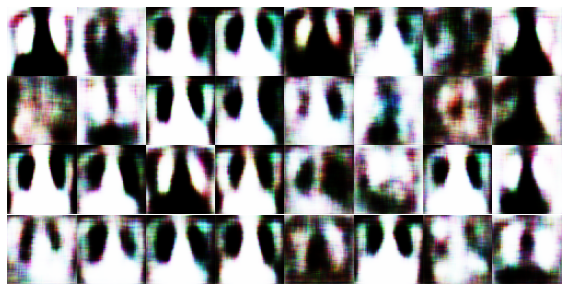

     Batch 5/9 generator loss | discriminator loss : -0.42216938734054565 | 0.24181073904037476 - batch took 8.446535587310791 s.
     Batch 6/9 generator loss | discriminator loss : -0.36100295186042786 | -0.47141754627227783 - batch took 8.446424722671509 s.
     Batch 7/9 generator loss | discriminator loss : -0.4606100022792816 | -0.6261257529258728 - batch took 6.624318838119507 s.
     Batch 8/9 generator loss | discriminator loss : -0.4305869936943054 | -0.48186957836151123 - batch took 7.137435674667358 s.
     Batch 9/9 generator loss | discriminator loss : -0.3451518416404724 | -0.5388352870941162 - batch took 7.733520746231079 s.


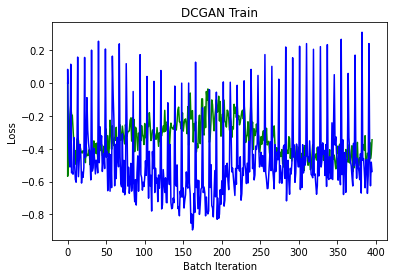

Epoch 45/100 :
     Batch 1/9 generator loss | discriminator loss : -0.4862895607948303 | -0.549113541841507 - batch took 6.958074569702148 s.
     Batch 2/9 generator loss | discriminator loss : -0.11821646988391876 | -0.4950442910194397 - batch took 7.238478899002075 s.
     Batch 3/9 generator loss | discriminator loss : -0.1978244185447693 | -0.6483578979969025 - batch took 8.182671308517456 s.
     Batch 4/9 generator loss | discriminator loss : -0.1920766532421112 | -0.622582882642746 - batch took 7.185545921325684 s.


<Figure size 432x288 with 0 Axes>

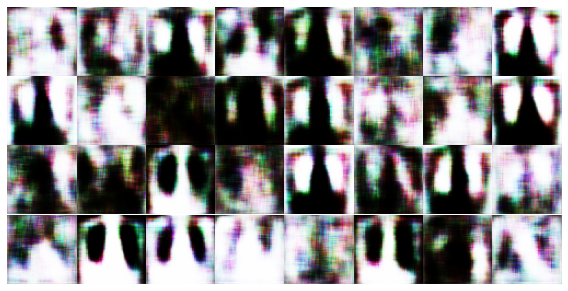

     Batch 5/9 generator loss | discriminator loss : -0.11601385474205017 | -0.06329815089702606 - batch took 8.915237188339233 s.
     Batch 6/9 generator loss | discriminator loss : -0.10047536343336105 | -0.7287561595439911 - batch took 7.021396636962891 s.
     Batch 7/9 generator loss | discriminator loss : -0.10247597098350525 | -0.5229742079973221 - batch took 6.967350244522095 s.
     Batch 8/9 generator loss | discriminator loss : -0.11313669383525848 | -0.5099768042564392 - batch took 6.644034385681152 s.
     Batch 9/9 generator loss | discriminator loss : -0.1568717211484909 | -0.6520939916372299 - batch took 7.572838306427002 s.


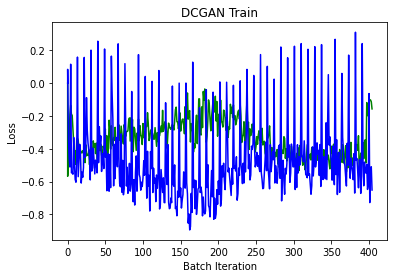

Epoch 46/100 :
     Batch 1/9 generator loss | discriminator loss : -0.0912894755601883 | -0.7899600863456726 - batch took 6.696650981903076 s.
     Batch 2/9 generator loss | discriminator loss : -0.0740465521812439 | -0.7804911136627197 - batch took 7.503742694854736 s.
     Batch 3/9 generator loss | discriminator loss : -0.14156164228916168 | -0.6606810241937637 - batch took 5.760564088821411 s.
     Batch 4/9 generator loss | discriminator loss : -0.1160380095243454 | -0.735919401049614 - batch took 7.028255224227905 s.


<Figure size 432x288 with 0 Axes>

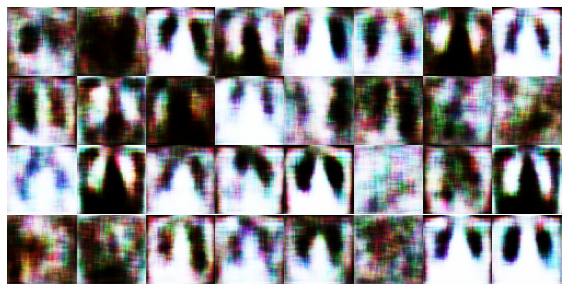

     Batch 5/9 generator loss | discriminator loss : -0.1093021035194397 | 0.006225854158401489 - batch took 9.459830284118652 s.
     Batch 6/9 generator loss | discriminator loss : -0.09688987582921982 | -0.6638205200433731 - batch took 6.845869779586792 s.
     Batch 7/9 generator loss | discriminator loss : -0.10084770619869232 | -0.41754254698753357 - batch took 7.174678325653076 s.
     Batch 8/9 generator loss | discriminator loss : -0.24743495881557465 | -0.7170486897230148 - batch took 7.652494430541992 s.
     Batch 9/9 generator loss | discriminator loss : -0.18179090321063995 | -0.7116532921791077 - batch took 6.7763354778289795 s.


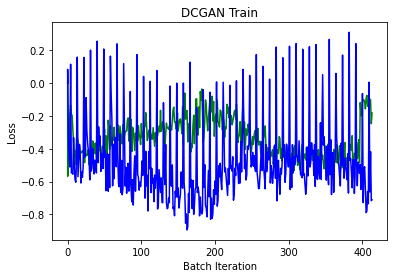

Epoch 47/100 :
     Batch 1/9 generator loss | discriminator loss : -0.12545540928840637 | -0.7347573041915894 - batch took 7.4717748165130615 s.
     Batch 2/9 generator loss | discriminator loss : -0.15046681463718414 | -0.7807578444480896 - batch took 7.647846221923828 s.
     Batch 3/9 generator loss | discriminator loss : -0.22535660862922668 | -0.45159634947776794 - batch took 7.099297761917114 s.
     Batch 4/9 generator loss | discriminator loss : -0.24792352318763733 | -0.5854541063308716 - batch took 6.868959426879883 s.


<Figure size 432x288 with 0 Axes>

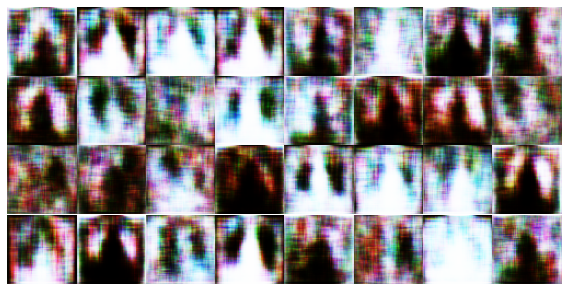

     Batch 5/9 generator loss | discriminator loss : -0.21206501126289368 | -0.05340456962585449 - batch took 8.521452903747559 s.
     Batch 6/9 generator loss | discriminator loss : -0.26231876015663147 | -0.4295653700828552 - batch took 6.668057680130005 s.
     Batch 7/9 generator loss | discriminator loss : -0.23636022210121155 | -0.6114934384822845 - batch took 6.702749013900757 s.
     Batch 8/9 generator loss | discriminator loss : -0.2284434288740158 | -0.6177449822425842 - batch took 7.058051586151123 s.
     Batch 9/9 generator loss | discriminator loss : -0.1733519434928894 | -0.4670819938182831 - batch took 6.470478296279907 s.


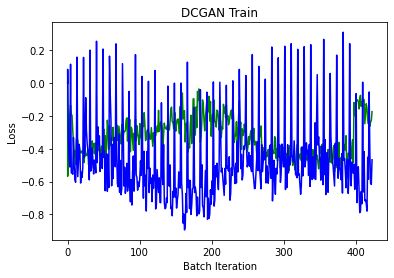

Epoch 48/100 :
     Batch 1/9 generator loss | discriminator loss : -0.27154457569122314 | -0.7068135887384415 - batch took 7.346028566360474 s.
     Batch 2/9 generator loss | discriminator loss : -0.24472835659980774 | -0.4984191358089447 - batch took 5.74945068359375 s.
     Batch 3/9 generator loss | discriminator loss : -0.09429290145635605 | -0.5333060622215271 - batch took 7.043919324874878 s.
     Batch 4/9 generator loss | discriminator loss : -0.16787639260292053 | -0.5643554925918579 - batch took 8.239365100860596 s.


<Figure size 432x288 with 0 Axes>

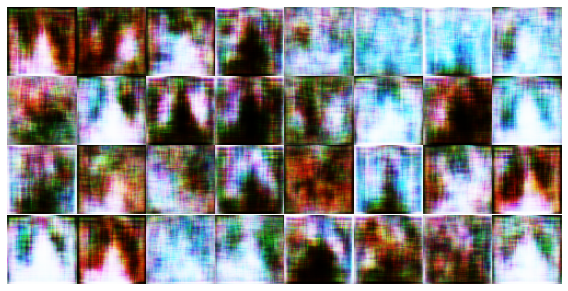

     Batch 5/9 generator loss | discriminator loss : -0.14374306797981262 | -0.008925706148147583 - batch took 8.092543601989746 s.
     Batch 6/9 generator loss | discriminator loss : -0.23107010126113892 | -0.6524189412593842 - batch took 7.378523349761963 s.
     Batch 7/9 generator loss | discriminator loss : -0.1881566196680069 | -0.6672345995903015 - batch took 7.74416708946228 s.
     Batch 8/9 generator loss | discriminator loss : -0.18047644197940826 | -0.6211640238761902 - batch took 6.743733167648315 s.
     Batch 9/9 generator loss | discriminator loss : -0.1940135359764099 | -0.6964931935071945 - batch took 7.283357620239258 s.


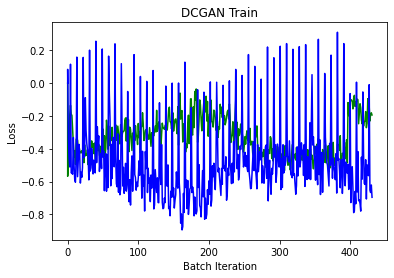

Epoch 49/100 :
     Batch 1/9 generator loss | discriminator loss : -0.2255646139383316 | -0.69591423869133 - batch took 7.825807809829712 s.
     Batch 2/9 generator loss | discriminator loss : -0.26814767718315125 | -0.3969125747680664 - batch took 7.140499114990234 s.
     Batch 3/9 generator loss | discriminator loss : -0.27238667011260986 | -0.504114419221878 - batch took 6.949400901794434 s.
     Batch 4/9 generator loss | discriminator loss : -0.3194129168987274 | -0.5237091779708862 - batch took 7.089658975601196 s.


<Figure size 432x288 with 0 Axes>

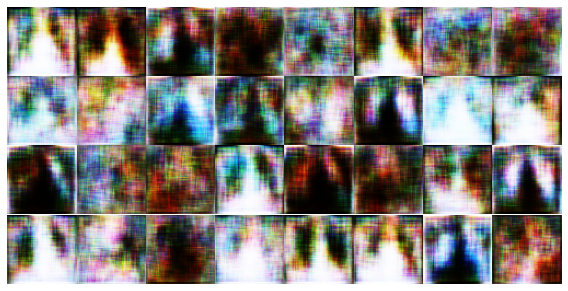

     Batch 5/9 generator loss | discriminator loss : -0.24440734088420868 | 0.06393927335739136 - batch took 7.673335552215576 s.
     Batch 6/9 generator loss | discriminator loss : -0.21435701847076416 | -0.5517546534538269 - batch took 6.901058197021484 s.
     Batch 7/9 generator loss | discriminator loss : -0.2526765465736389 | -0.5678354501724243 - batch took 7.095347881317139 s.
     Batch 8/9 generator loss | discriminator loss : -0.3106870651245117 | -0.4436342716217041 - batch took 6.474459409713745 s.
     Batch 9/9 generator loss | discriminator loss : -0.258053719997406 | -0.5197506546974182 - batch took 7.117727279663086 s.


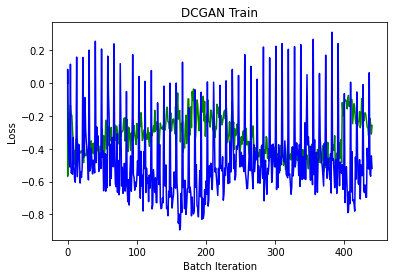

Epoch 50/100 :
     Batch 1/9 generator loss | discriminator loss : -0.3163510859012604 | -0.5406301617622375 - batch took 6.045887470245361 s.
     Batch 2/9 generator loss | discriminator loss : -0.13997794687747955 | -0.38184118270874023 - batch took 7.032918691635132 s.
     Batch 3/9 generator loss | discriminator loss : -0.14446841180324554 | -0.6264204978942871 - batch took 8.709509134292603 s.
     Batch 4/9 generator loss | discriminator loss : -0.10372457653284073 | -0.5792887806892395 - batch took 6.539219617843628 s.


<Figure size 432x288 with 0 Axes>

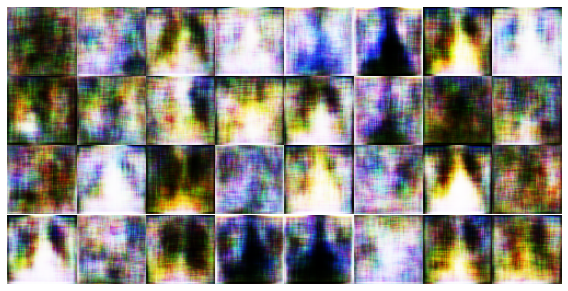

     Batch 5/9 generator loss | discriminator loss : -0.07788717746734619 | -0.05850288271903992 - batch took 9.158611297607422 s.
     Batch 6/9 generator loss | discriminator loss : -0.13820984959602356 | -0.48127683997154236 - batch took 7.622899055480957 s.
     Batch 7/9 generator loss | discriminator loss : -0.12309272587299347 | -0.5635935664176941 - batch took 7.28603982925415 s.
     Batch 8/9 generator loss | discriminator loss : -0.11273029446601868 | -0.653353214263916 - batch took 7.309934377670288 s.
     Batch 9/9 generator loss | discriminator loss : -0.21823027729988098 | -0.6201920807361603 - batch took 8.150307416915894 s.


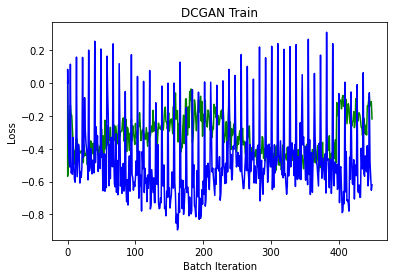

Epoch 51/100 :
     Batch 1/9 generator loss | discriminator loss : -0.27326974272727966 | -0.41904425621032715 - batch took 7.335045576095581 s.
     Batch 2/9 generator loss | discriminator loss : -0.31719771027565 | -0.5846178531646729 - batch took 7.388259172439575 s.
     Batch 3/9 generator loss | discriminator loss : -0.26009684801101685 | -0.6472043991088867 - batch took 7.063750505447388 s.
     Batch 4/9 generator loss | discriminator loss : -0.30787545442581177 | -0.6074002683162689 - batch took 6.459148645401001 s.


<Figure size 432x288 with 0 Axes>

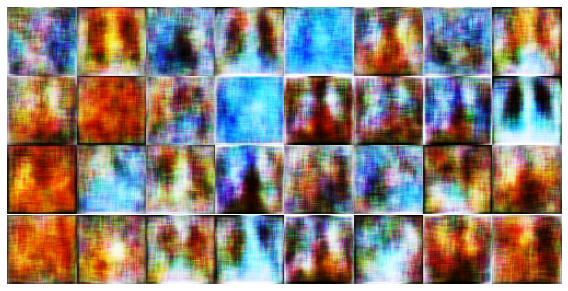

     Batch 5/9 generator loss | discriminator loss : -0.23430025577545166 | 0.023727625608444214 - batch took 7.952394008636475 s.
     Batch 6/9 generator loss | discriminator loss : -0.3453858196735382 | -0.5255641937255859 - batch took 7.283061981201172 s.
     Batch 7/9 generator loss | discriminator loss : -0.348436564207077 | -0.6012793183326721 - batch took 6.490914344787598 s.
     Batch 8/9 generator loss | discriminator loss : -0.3504799008369446 | -0.4737485647201538 - batch took 7.142417669296265 s.
     Batch 9/9 generator loss | discriminator loss : -0.3689457178115845 | -0.5423316359519958 - batch took 5.720183610916138 s.


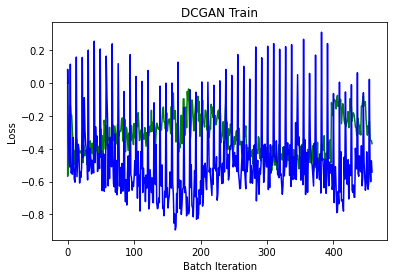

Epoch 52/100 :
     Batch 1/9 generator loss | discriminator loss : -0.3080742359161377 | -0.6505120992660522 - batch took 7.282387733459473 s.
     Batch 2/9 generator loss | discriminator loss : -0.28973710536956787 | -0.6664117872714996 - batch took 8.257864475250244 s.
     Batch 3/9 generator loss | discriminator loss : -0.3021010160446167 | -0.6010595858097076 - batch took 6.6662914752960205 s.
     Batch 4/9 generator loss | discriminator loss : -0.27219071984291077 | -0.5805791616439819 - batch took 7.190409898757935 s.


<Figure size 432x288 with 0 Axes>

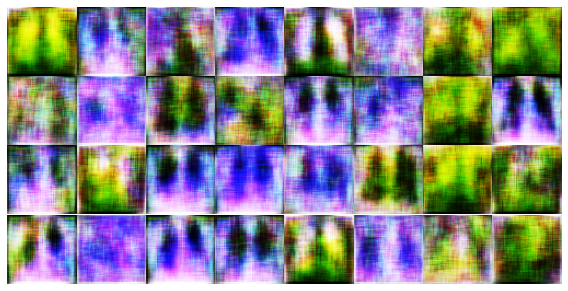

     Batch 5/9 generator loss | discriminator loss : -0.25522464513778687 | 0.16324831545352936 - batch took 9.20885705947876 s.
     Batch 6/9 generator loss | discriminator loss : -0.15763407945632935 | -0.49556270241737366 - batch took 7.018008708953857 s.
     Batch 7/9 generator loss | discriminator loss : -0.21053506433963776 | -0.6638213694095612 - batch took 7.363945007324219 s.
     Batch 8/9 generator loss | discriminator loss : -0.17382405698299408 | -0.670737624168396 - batch took 7.626585483551025 s.
     Batch 9/9 generator loss | discriminator loss : -0.3170710802078247 | -0.4519503116607666 - batch took 7.112277507781982 s.


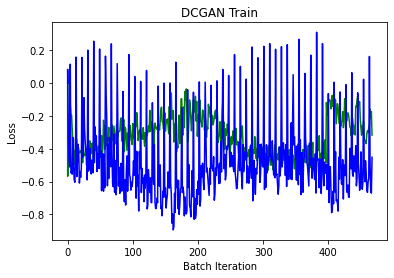

Epoch 53/100 :
     Batch 1/9 generator loss | discriminator loss : -0.2900736927986145 | -0.6115512847900391 - batch took 7.14609694480896 s.
     Batch 2/9 generator loss | discriminator loss : -0.3607088327407837 | -0.6463648676872253 - batch took 7.063184022903442 s.
     Batch 3/9 generator loss | discriminator loss : -0.18876913189888 | -0.6264962255954742 - batch took 6.510043621063232 s.
     Batch 4/9 generator loss | discriminator loss : -0.22912853956222534 | -0.5583862066268921 - batch took 6.677623271942139 s.


<Figure size 432x288 with 0 Axes>

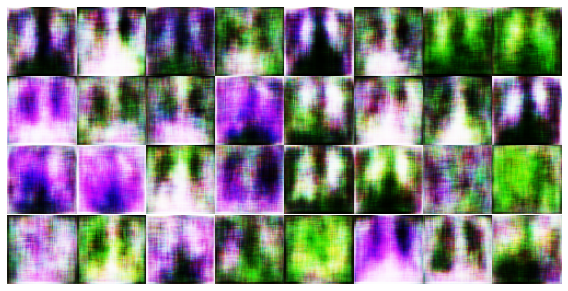

     Batch 5/9 generator loss | discriminator loss : -0.25990360975265503 | 0.09377005696296692 - batch took 8.493338108062744 s.
     Batch 6/9 generator loss | discriminator loss : -0.3194276690483093 | -0.4841984510421753 - batch took 6.694082021713257 s.
     Batch 7/9 generator loss | discriminator loss : -0.27447301149368286 | -0.425631582736969 - batch took 7.108493089675903 s.
     Batch 8/9 generator loss | discriminator loss : -0.25760748982429504 | -0.6154726147651672 - batch took 5.7206504344940186 s.
     Batch 9/9 generator loss | discriminator loss : -0.2830066680908203 | -0.6671003103256226 - batch took 7.099360942840576 s.


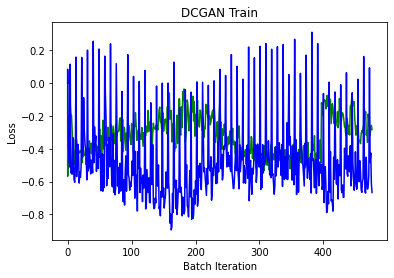

Epoch 54/100 :
     Batch 1/9 generator loss | discriminator loss : -0.2828497886657715 | -0.6362096071243286 - batch took 8.503846168518066 s.
     Batch 2/9 generator loss | discriminator loss : -0.24118660390377045 | -0.42846906185150146 - batch took 6.688654661178589 s.
     Batch 3/9 generator loss | discriminator loss : -0.35103097558021545 | -0.5652464628219604 - batch took 7.1644322872161865 s.
     Batch 4/9 generator loss | discriminator loss : -0.37120091915130615 | -0.6227682828903198 - batch took 7.729270935058594 s.


<Figure size 432x288 with 0 Axes>

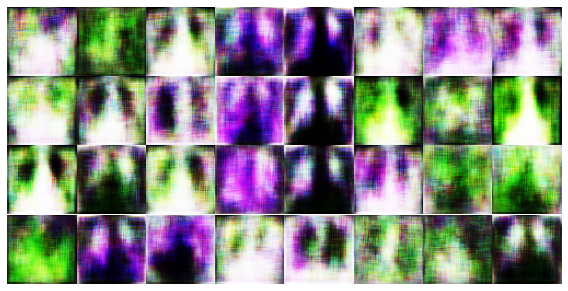

     Batch 5/9 generator loss | discriminator loss : -0.24538187682628632 | 0.16405093669891357 - batch took 8.181520938873291 s.
     Batch 6/9 generator loss | discriminator loss : -0.21844476461410522 | -0.3723675012588501 - batch took 7.545320749282837 s.
     Batch 7/9 generator loss | discriminator loss : -0.22402966022491455 | -0.5969785451889038 - batch took 7.655559778213501 s.
     Batch 8/9 generator loss | discriminator loss : -0.3403685688972473 | -0.3500654995441437 - batch took 7.148449897766113 s.
     Batch 9/9 generator loss | discriminator loss : -0.3587298095226288 | -0.5348440110683441 - batch took 6.952171087265015 s.


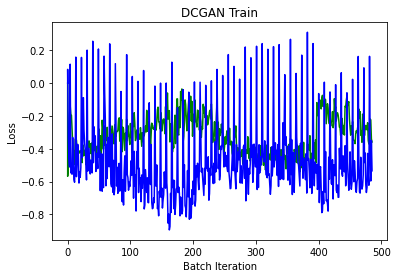

Epoch 55/100 :
     Batch 1/9 generator loss | discriminator loss : -0.3584902882575989 | -0.6434409618377686 - batch took 7.275372505187988 s.
     Batch 2/9 generator loss | discriminator loss : -0.3337869346141815 | -0.7075441181659698 - batch took 6.453824281692505 s.
     Batch 3/9 generator loss | discriminator loss : -0.44932663440704346 | -0.5259325504302979 - batch took 6.920563697814941 s.
     Batch 4/9 generator loss | discriminator loss : -0.2672926187515259 | -0.45900869369506836 - batch took 7.193558692932129 s.


<Figure size 432x288 with 0 Axes>

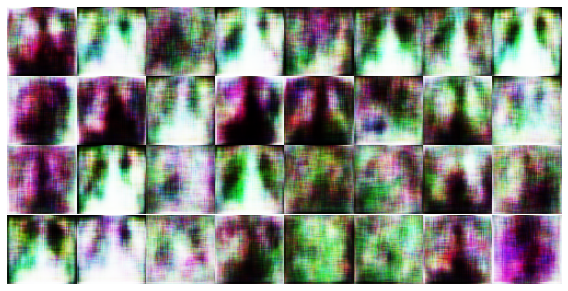

     Batch 5/9 generator loss | discriminator loss : -0.1905827820301056 | 0.11639375984668732 - batch took 9.6784029006958 s.
     Batch 6/9 generator loss | discriminator loss : -0.2332596331834793 | -0.5417205691337585 - batch took 7.141998291015625 s.
     Batch 7/9 generator loss | discriminator loss : -0.2207544445991516 | -0.5210431218147278 - batch took 5.957131385803223 s.
     Batch 8/9 generator loss | discriminator loss : -0.26630574464797974 | -0.48932236433029175 - batch took 7.574499845504761 s.
     Batch 9/9 generator loss | discriminator loss : -0.29481783509254456 | -0.563804030418396 - batch took 8.637271642684937 s.


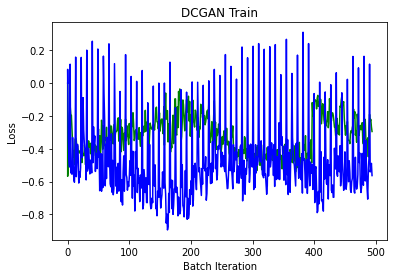

Epoch 56/100 :
     Batch 1/9 generator loss | discriminator loss : -0.19887486100196838 | -0.670257568359375 - batch took 6.926424503326416 s.
     Batch 2/9 generator loss | discriminator loss : -0.3529815077781677 | -0.6651228070259094 - batch took 7.655439376831055 s.
     Batch 3/9 generator loss | discriminator loss : -0.30863311886787415 | -0.6339148283004761 - batch took 7.750447750091553 s.
     Batch 4/9 generator loss | discriminator loss : -0.2383461594581604 | -0.4709140658378601 - batch took 6.77158522605896 s.


<Figure size 432x288 with 0 Axes>

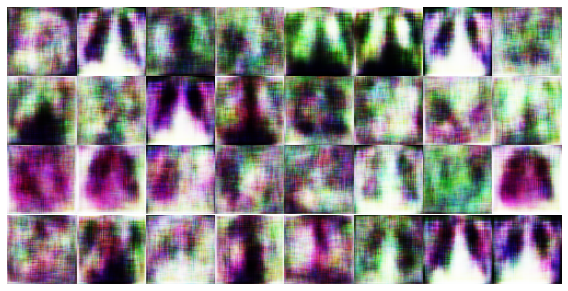

     Batch 5/9 generator loss | discriminator loss : -0.18752920627593994 | 0.04884271323680878 - batch took 8.794349670410156 s.
     Batch 6/9 generator loss | discriminator loss : -0.25229915976524353 | -0.5751881003379822 - batch took 7.9050984382629395 s.
     Batch 7/9 generator loss | discriminator loss : -0.344992995262146 | -0.34720003604888916 - batch took 7.11680269241333 s.
     Batch 8/9 generator loss | discriminator loss : -0.3637467920780182 | -0.4618178606033325 - batch took 6.98304295539856 s.
     Batch 9/9 generator loss | discriminator loss : -0.3812417984008789 | -0.6422135233879089 - batch took 7.116525411605835 s.


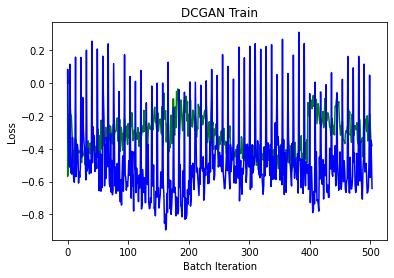

Epoch 57/100 :
     Batch 1/9 generator loss | discriminator loss : -0.39927056431770325 | -0.6301582753658295 - batch took 6.7083306312561035 s.
     Batch 2/9 generator loss | discriminator loss : -0.4656550884246826 | -0.5114656686782837 - batch took 6.679098844528198 s.
     Batch 3/9 generator loss | discriminator loss : -0.38985106348991394 | -0.5616238415241241 - batch took 7.116949558258057 s.
     Batch 4/9 generator loss | discriminator loss : -0.4162091612815857 | -0.4511849880218506 - batch took 6.467029333114624 s.


<Figure size 432x288 with 0 Axes>

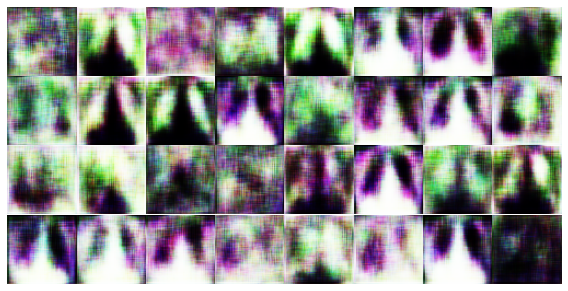

     Batch 5/9 generator loss | discriminator loss : -0.34111738204956055 | 0.10121643543243408 - batch took 8.419047117233276 s.
     Batch 6/9 generator loss | discriminator loss : -0.4395851194858551 | -0.8095679432153702 - batch took 6.016179323196411 s.
     Batch 7/9 generator loss | discriminator loss : -0.4539812207221985 | -0.41520875692367554 - batch took 7.134032726287842 s.
     Batch 8/9 generator loss | discriminator loss : -0.46600964665412903 | -0.5136862993240356 - batch took 8.302954196929932 s.
     Batch 9/9 generator loss | discriminator loss : -0.40190187096595764 | -0.5196999311447144 - batch took 6.693848133087158 s.


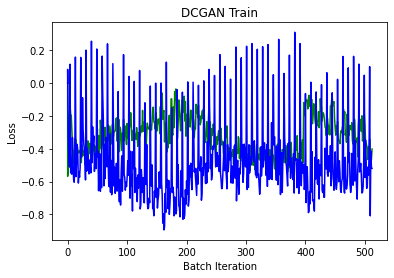

Epoch 58/100 :
     Batch 1/9 generator loss | discriminator loss : -0.3763718605041504 | -0.5194371342658997 - batch took 7.414425611495972 s.
     Batch 2/9 generator loss | discriminator loss : -0.3263939619064331 | -0.6390054225921631 - batch took 7.711731910705566 s.
     Batch 3/9 generator loss | discriminator loss : -0.26822006702423096 | -0.6076216697692871 - batch took 6.821514129638672 s.
     Batch 4/9 generator loss | discriminator loss : -0.32866936922073364 | -0.6682479083538055 - batch took 7.306517839431763 s.


<Figure size 432x288 with 0 Axes>

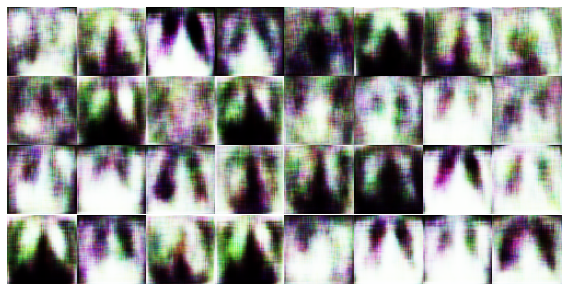

     Batch 5/9 generator loss | discriminator loss : -0.20127001404762268 | 0.1809001863002777 - batch took 9.092209577560425 s.
     Batch 6/9 generator loss | discriminator loss : -0.39399009943008423 | -0.21961775422096252 - batch took 7.4064860343933105 s.
     Batch 7/9 generator loss | discriminator loss : -0.42081576585769653 | -0.5524115860462189 - batch took 6.958124399185181 s.
     Batch 8/9 generator loss | discriminator loss : -0.32910603284835815 | -0.5210554301738739 - batch took 7.087398290634155 s.
     Batch 9/9 generator loss | discriminator loss : -0.344548761844635 | -0.4429337978363037 - batch took 6.451423645019531 s.


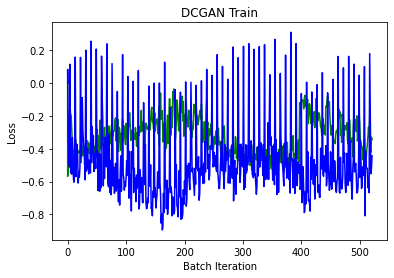

Epoch 59/100 :
     Batch 1/9 generator loss | discriminator loss : -0.258910596370697 | -0.5779694318771362 - batch took 6.926960706710815 s.
     Batch 2/9 generator loss | discriminator loss : -0.3379254639148712 | -0.4970366954803467 - batch took 7.07506799697876 s.
     Batch 3/9 generator loss | discriminator loss : -0.4967751204967499 | -0.5652194023132324 - batch took 6.519655227661133 s.
     Batch 4/9 generator loss | discriminator loss : -0.38194218277931213 | -0.5792081952095032 - batch took 7.157914161682129 s.
     Batch 5/9 generator loss | discriminator loss : -0.39451873302459717 | 0.16091103851795197 - batch took 5.7951531410217285 s.
     Batch 6/9 generator loss | discriminator loss : -0.34678512811660767 | -0.5102300345897675 - batch took 7.07565450668335 s.
     Batch 7/9 generator loss | discriminator loss : -0.20570380985736847 | -0.43130701780319214 - batch took 8.32027292251587 s.
     Batch 8/9 generator loss | discriminator loss : -0.19020907580852509 | -0.4

<Figure size 432x288 with 0 Axes>

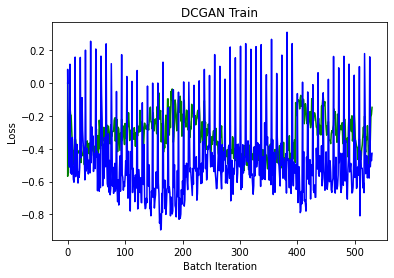

Epoch 60/100 :
     Batch 1/9 generator loss | discriminator loss : -0.16061857342720032 | -0.5221953690052032 - batch took 8.039849042892456 s.
     Batch 2/9 generator loss | discriminator loss : -0.22861048579216003 | -0.5143086314201355 - batch took 6.711588382720947 s.
     Batch 3/9 generator loss | discriminator loss : -0.22470127046108246 | -0.49986690282821655 - batch took 7.788892507553101 s.
     Batch 4/9 generator loss | discriminator loss : -0.22144433856010437 | -0.5630774796009064 - batch took 7.648892164230347 s.


<Figure size 432x288 with 0 Axes>

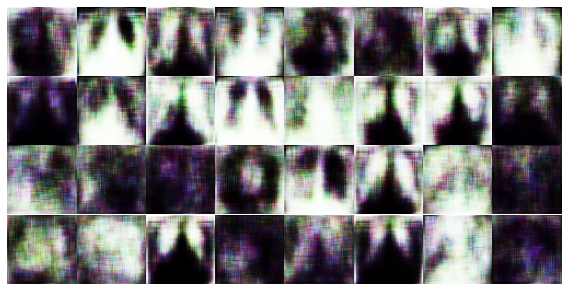

     Batch 5/9 generator loss | discriminator loss : -0.22511407732963562 | 0.06127174198627472 - batch took 9.098646402359009 s.
     Batch 6/9 generator loss | discriminator loss : -0.21294401586055756 | -0.4001126289367676 - batch took 7.230107069015503 s.
     Batch 7/9 generator loss | discriminator loss : -0.27476269006729126 | -0.6680932343006134 - batch took 7.086310625076294 s.
     Batch 8/9 generator loss | discriminator loss : -0.19277822971343994 | -0.5497198104858398 - batch took 6.541959047317505 s.
     Batch 9/9 generator loss | discriminator loss : -0.3093652129173279 | -0.5744642615318298 - batch took 7.023564577102661 s.


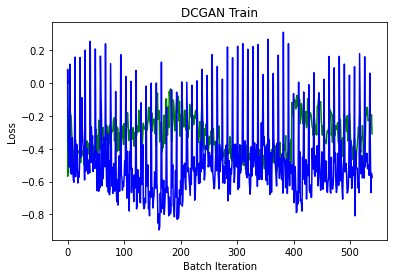

Epoch 61/100 :
     Batch 1/9 generator loss | discriminator loss : -0.29394543170928955 | -0.5249065458774567 - batch took 7.7680888175964355 s.
     Batch 2/9 generator loss | discriminator loss : -0.3372476100921631 | -0.3444054126739502 - batch took 6.559460639953613 s.
     Batch 3/9 generator loss | discriminator loss : -0.3247383236885071 | -0.693264365196228 - batch took 7.168635129928589 s.
     Batch 4/9 generator loss | discriminator loss : -0.3001363277435303 | -0.6304812431335449 - batch took 5.771224021911621 s.


<Figure size 432x288 with 0 Axes>

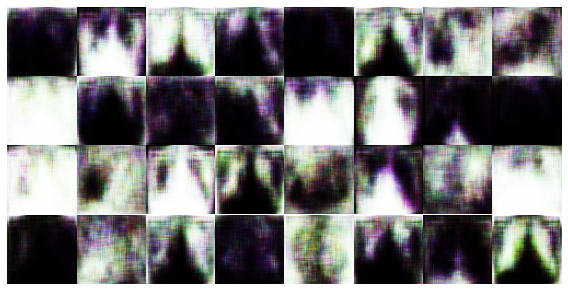

     Batch 5/9 generator loss | discriminator loss : -0.32538771629333496 | 0.006185665726661682 - batch took 8.582324743270874 s.
     Batch 6/9 generator loss | discriminator loss : -0.22152724862098694 | -0.4912037253379822 - batch took 8.499346494674683 s.
     Batch 7/9 generator loss | discriminator loss : -0.2969818711280823 | -0.5851870775222778 - batch took 6.669277191162109 s.
     Batch 8/9 generator loss | discriminator loss : -0.19441872835159302 | -0.4913223087787628 - batch took 7.152547597885132 s.
     Batch 9/9 generator loss | discriminator loss : -0.2494249939918518 | -0.6327509880065918 - batch took 7.754831075668335 s.


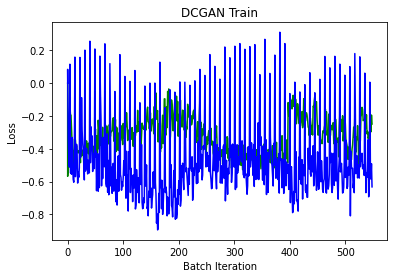

Epoch 62/100 :
     Batch 1/9 generator loss | discriminator loss : -0.3110976815223694 | -0.6043554246425629 - batch took 7.074865341186523 s.
     Batch 2/9 generator loss | discriminator loss : -0.33236414194107056 | -0.5796767473220825 - batch took 7.342024564743042 s.
     Batch 3/9 generator loss | discriminator loss : -0.2549143433570862 | -0.6519941687583923 - batch took 7.695813417434692 s.
     Batch 4/9 generator loss | discriminator loss : -0.3281225264072418 | -0.48585277795791626 - batch took 7.150040149688721 s.


<Figure size 432x288 with 0 Axes>

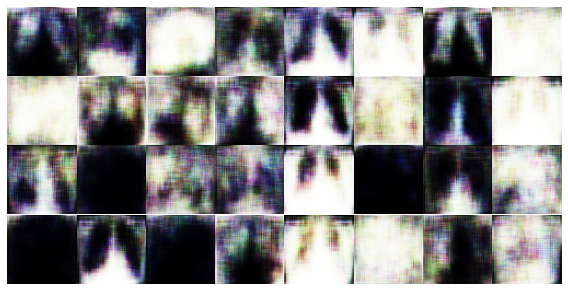

     Batch 5/9 generator loss | discriminator loss : -0.3149774670600891 | 0.14736664295196533 - batch took 8.232249975204468 s.
     Batch 6/9 generator loss | discriminator loss : -0.18538734316825867 | -0.48420780897140503 - batch took 7.303651571273804 s.
     Batch 7/9 generator loss | discriminator loss : -0.22309650480747223 | -0.7015752196311951 - batch took 6.522860765457153 s.
     Batch 8/9 generator loss | discriminator loss : -0.1989917755126953 | -0.6408789157867432 - batch took 6.72283673286438 s.
     Batch 9/9 generator loss | discriminator loss : -0.20987555384635925 | -0.47122740745544434 - batch took 7.165626287460327 s.


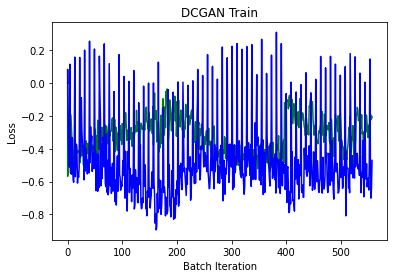

Epoch 63/100 :
     Batch 1/9 generator loss | discriminator loss : -0.23041972517967224 | -0.4893656373023987 - batch took 6.682926177978516 s.
     Batch 2/9 generator loss | discriminator loss : -0.21613894402980804 | -0.5987343788146973 - batch took 7.188822269439697 s.
     Batch 3/9 generator loss | discriminator loss : -0.26467910408973694 | -0.71197709441185 - batch took 5.788595676422119 s.
     Batch 4/9 generator loss | discriminator loss : -0.20733103156089783 | -0.630127340555191 - batch took 7.129544973373413 s.


<Figure size 432x288 with 0 Axes>

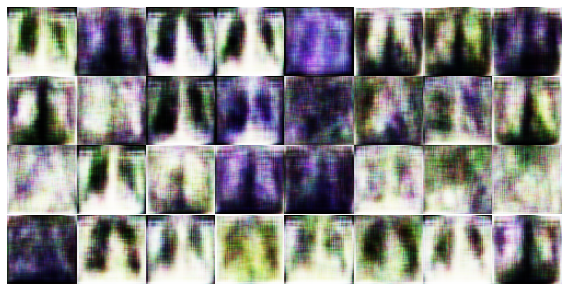

     Batch 5/9 generator loss | discriminator loss : -0.2027679681777954 | 0.016536951065063477 - batch took 9.819509744644165 s.
     Batch 6/9 generator loss | discriminator loss : -0.21200904250144958 | -0.5903950333595276 - batch took 6.922922611236572 s.
     Batch 7/9 generator loss | discriminator loss : -0.1261894702911377 | -0.4530547559261322 - batch took 7.188654899597168 s.
     Batch 8/9 generator loss | discriminator loss : -0.14302858710289001 | -0.49607449769973755 - batch took 7.72812032699585 s.
     Batch 9/9 generator loss | discriminator loss : -0.25243788957595825 | -0.597743570804596 - batch took 6.846791505813599 s.


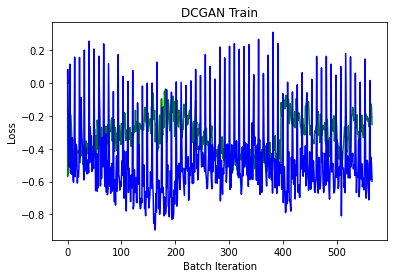

Epoch 64/100 :
     Batch 1/9 generator loss | discriminator loss : -0.1672382950782776 | -0.5748681724071503 - batch took 7.627532243728638 s.
     Batch 2/9 generator loss | discriminator loss : -0.212797611951828 | -0.49638432264328003 - batch took 7.713517904281616 s.
     Batch 3/9 generator loss | discriminator loss : -0.22936676442623138 | -0.3662111759185791 - batch took 7.163731813430786 s.
     Batch 4/9 generator loss | discriminator loss : -0.2013256847858429 | -0.6058182120323181 - batch took 6.936568975448608 s.


<Figure size 432x288 with 0 Axes>

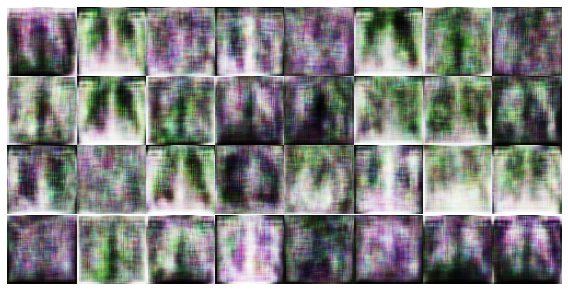

     Batch 5/9 generator loss | discriminator loss : -0.14178945124149323 | -0.0015076249837875366 - batch took 8.327213048934937 s.
     Batch 6/9 generator loss | discriminator loss : -0.19449490308761597 | -0.5262968242168427 - batch took 6.827958822250366 s.
     Batch 7/9 generator loss | discriminator loss : -0.17726612091064453 | -0.5803637206554413 - batch took 6.748623609542847 s.
     Batch 8/9 generator loss | discriminator loss : -0.137375608086586 | -0.4930473268032074 - batch took 7.133509635925293 s.
     Batch 9/9 generator loss | discriminator loss : -0.21540118753910065 | -0.4942944347858429 - batch took 6.551178216934204 s.


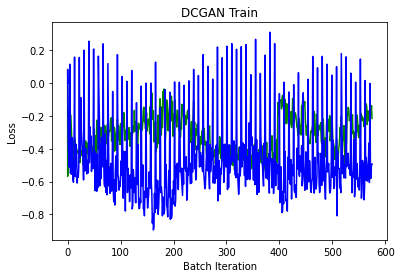

Epoch 65/100 :
     Batch 1/9 generator loss | discriminator loss : -0.1798013150691986 | -0.6103341579437256 - batch took 7.468079328536987 s.
     Batch 2/9 generator loss | discriminator loss : -0.16851948201656342 | -0.5495590269565582 - batch took 6.064723968505859 s.
     Batch 3/9 generator loss | discriminator loss : -0.1678663194179535 | -0.48805224895477295 - batch took 7.580011367797852 s.
     Batch 4/9 generator loss | discriminator loss : -0.1918824017047882 | -0.5617539584636688 - batch took 8.397864818572998 s.


<Figure size 432x288 with 0 Axes>

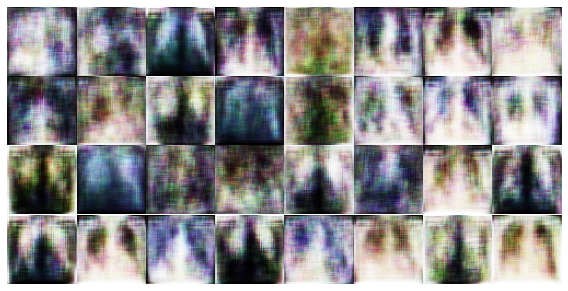

     Batch 5/9 generator loss | discriminator loss : -0.14512217044830322 | -0.015617311000823975 - batch took 8.679108381271362 s.
     Batch 6/9 generator loss | discriminator loss : -0.1601313352584839 | -0.46714431047439575 - batch took 7.143272399902344 s.
     Batch 7/9 generator loss | discriminator loss : -0.2388186901807785 | -0.5867827534675598 - batch took 8.206804752349854 s.
     Batch 8/9 generator loss | discriminator loss : -0.22351115942001343 | -0.6344444453716278 - batch took 6.9952309131622314 s.
     Batch 9/9 generator loss | discriminator loss : -0.3571194112300873 | -0.6647511124610901 - batch took 7.8258771896362305 s.


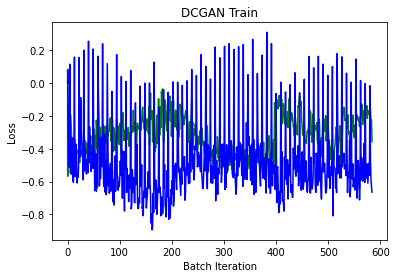

Epoch 66/100 :
     Batch 1/9 generator loss | discriminator loss : -0.20397096872329712 | -0.6600187420845032 - batch took 7.914405584335327 s.
     Batch 2/9 generator loss | discriminator loss : -0.2401990294456482 | -0.3928084969520569 - batch took 7.672736644744873 s.
     Batch 3/9 generator loss | discriminator loss : -0.24704143404960632 | -0.4682745635509491 - batch took 7.03134560585022 s.
     Batch 4/9 generator loss | discriminator loss : -0.3418680727481842 | -0.5404952466487885 - batch took 7.122972011566162 s.


<Figure size 432x288 with 0 Axes>

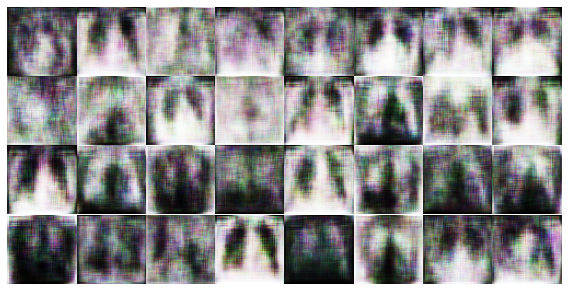

     Batch 5/9 generator loss | discriminator loss : -0.28473472595214844 | 0.08453649282455444 - batch took 7.992850303649902 s.
     Batch 6/9 generator loss | discriminator loss : -0.1750997006893158 | -0.4947933256626129 - batch took 6.963933706283569 s.
     Batch 7/9 generator loss | discriminator loss : -0.2435951828956604 | -0.40381309390068054 - batch took 7.175546169281006 s.
     Batch 8/9 generator loss | discriminator loss : -0.21802514791488647 | -0.5285670161247253 - batch took 6.504958152770996 s.
     Batch 9/9 generator loss | discriminator loss : -0.22788313031196594 | -0.6001490354537964 - batch took 7.215113162994385 s.


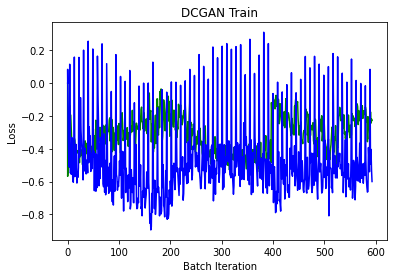

Epoch 67/100 :
     Batch 1/9 generator loss | discriminator loss : -0.16496752202510834 | -0.6364931762218475 - batch took 6.14028787612915 s.
     Batch 2/9 generator loss | discriminator loss : -0.19406649470329285 | -0.5879717767238617 - batch took 7.114383697509766 s.
     Batch 3/9 generator loss | discriminator loss : -0.19711214303970337 | -0.5683126151561737 - batch took 8.308597326278687 s.
     Batch 4/9 generator loss | discriminator loss : -0.19088761508464813 | -0.6349665522575378 - batch took 6.742310523986816 s.


<Figure size 432x288 with 0 Axes>

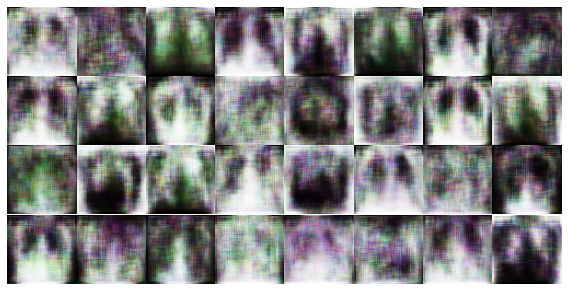

     Batch 5/9 generator loss | discriminator loss : -0.08887813240289688 | 0.07652468979358673 - batch took 12.43170690536499 s.
     Batch 6/9 generator loss | discriminator loss : -0.19740545749664307 | -0.53695347905159 - batch took 8.060474872589111 s.
     Batch 7/9 generator loss | discriminator loss : -0.16308681666851044 | -0.5094897150993347 - batch took 6.776105642318726 s.
     Batch 8/9 generator loss | discriminator loss : -0.1968935877084732 | -0.5784936547279358 - batch took 7.3796374797821045 s.
     Batch 9/9 generator loss | discriminator loss : -0.1956099569797516 | -0.6612922251224518 - batch took 7.61960506439209 s.


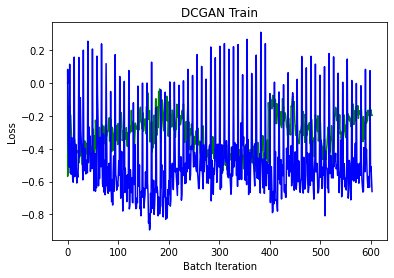

Epoch 68/100 :
     Batch 1/9 generator loss | discriminator loss : -0.22171737253665924 | -0.3247705399990082 - batch took 7.541980504989624 s.
     Batch 2/9 generator loss | discriminator loss : -0.17601865530014038 | -0.5661079287528992 - batch took 7.032105207443237 s.
     Batch 3/9 generator loss | discriminator loss : -0.1580493003129959 | -0.46004098653793335 - batch took 7.174646854400635 s.
     Batch 4/9 generator loss | discriminator loss : -0.20411065220832825 | -0.6060405075550079 - batch took 6.46264123916626 s.


<Figure size 432x288 with 0 Axes>

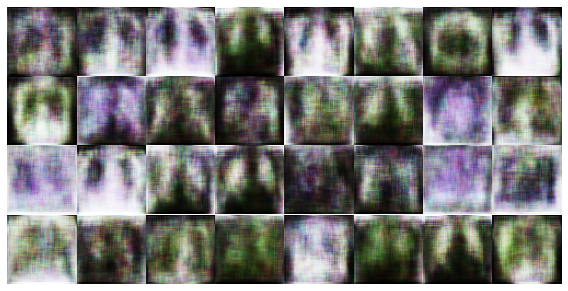

     Batch 5/9 generator loss | discriminator loss : -0.11981288343667984 | -0.03571726381778717 - batch took 8.054087400436401 s.
     Batch 6/9 generator loss | discriminator loss : -0.1828858107328415 | -0.39281052350997925 - batch took 7.405079126358032 s.
     Batch 7/9 generator loss | discriminator loss : -0.2110329270362854 | -0.4323674142360687 - batch took 6.561117649078369 s.
     Batch 8/9 generator loss | discriminator loss : -0.2305721640586853 | -0.6408582925796509 - batch took 7.177306413650513 s.
     Batch 9/9 generator loss | discriminator loss : -0.2124032825231552 | -0.5335225164890289 - batch took 5.816038370132446 s.


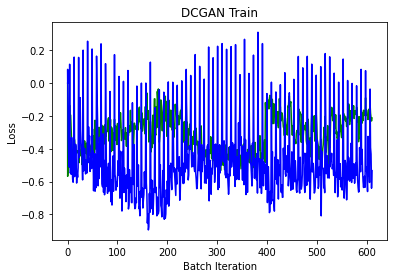

Epoch 69/100 :
     Batch 1/9 generator loss | discriminator loss : -0.1591658592224121 | -0.5964312553405762 - batch took 7.375 s.
     Batch 2/9 generator loss | discriminator loss : -0.2105398178100586 | -0.5938338339328766 - batch took 8.256304264068604 s.
     Batch 3/9 generator loss | discriminator loss : -0.1847965270280838 | -0.6248345971107483 - batch took 6.68384313583374 s.
     Batch 4/9 generator loss | discriminator loss : -0.17328518629074097 | -0.5432308912277222 - batch took 7.219058036804199 s.


<Figure size 432x288 with 0 Axes>

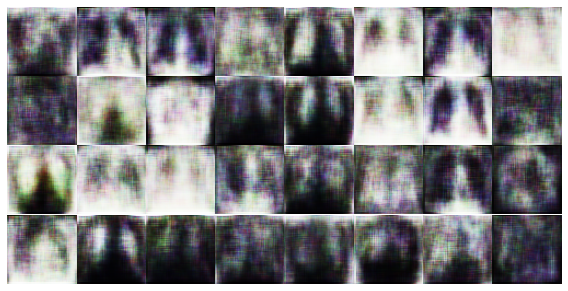

     Batch 5/9 generator loss | discriminator loss : -0.12846103310585022 | -0.016274988651275635 - batch took 9.264756679534912 s.
     Batch 6/9 generator loss | discriminator loss : -0.17470672726631165 | -0.5915887951850891 - batch took 7.050864219665527 s.
     Batch 7/9 generator loss | discriminator loss : -0.1810653656721115 | -0.590772271156311 - batch took 7.386088132858276 s.
     Batch 8/9 generator loss | discriminator loss : -0.1621313840150833 | -0.7129120230674744 - batch took 7.736219882965088 s.
     Batch 9/9 generator loss | discriminator loss : -0.27122801542282104 | -0.40463244915008545 - batch took 7.18468451499939 s.


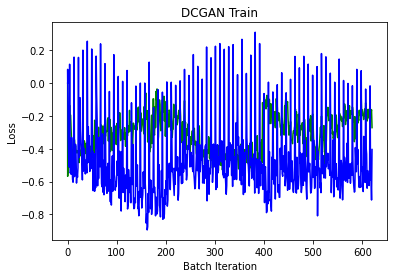

Epoch 70/100 :
     Batch 1/9 generator loss | discriminator loss : -0.2779339551925659 | -0.632434070110321 - batch took 7.226170301437378 s.
     Batch 2/9 generator loss | discriminator loss : -0.22417712211608887 | -0.5383884310722351 - batch took 7.01146674156189 s.
     Batch 3/9 generator loss | discriminator loss : -0.15897230803966522 | -0.48472797870635986 - batch took 6.96446681022644 s.
     Batch 4/9 generator loss | discriminator loss : -0.19158349931240082 | -0.5812318325042725 - batch took 6.713131904602051 s.


<Figure size 432x288 with 0 Axes>

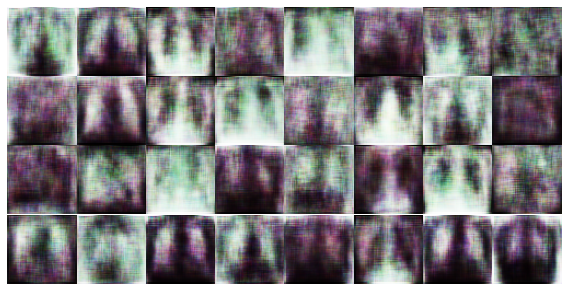

     Batch 5/9 generator loss | discriminator loss : -0.15966780483722687 | -0.03617323935031891 - batch took 9.037651300430298 s.
     Batch 6/9 generator loss | discriminator loss : -0.24817003309726715 | -0.507267415523529 - batch took 6.772134780883789 s.
     Batch 7/9 generator loss | discriminator loss : -0.2602405846118927 | -0.5336021482944489 - batch took 7.4975996017456055 s.
     Batch 8/9 generator loss | discriminator loss : -0.1879262924194336 | -0.597651481628418 - batch took 5.890545606613159 s.
     Batch 9/9 generator loss | discriminator loss : -0.18232399225234985 | -0.5601244568824768 - batch took 7.133152723312378 s.


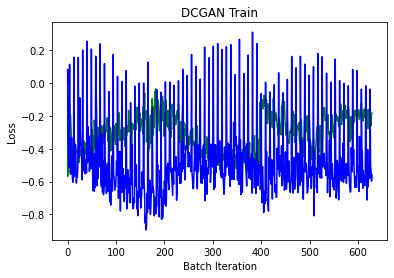

Epoch 71/100 :
     Batch 1/9 generator loss | discriminator loss : -0.2163390815258026 | -0.5937834978103638 - batch took 9.083078384399414 s.
     Batch 2/9 generator loss | discriminator loss : -0.2001715898513794 | -0.6337190568447113 - batch took 6.696459531784058 s.
     Batch 3/9 generator loss | discriminator loss : -0.21182440221309662 | -0.5850902199745178 - batch took 7.222632646560669 s.
     Batch 4/9 generator loss | discriminator loss : -0.32746756076812744 | -0.46597328782081604 - batch took 7.7773401737213135 s.


<Figure size 432x288 with 0 Axes>

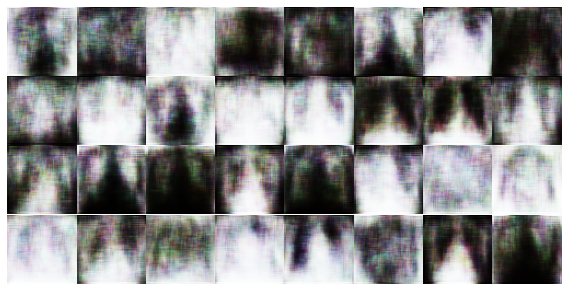

     Batch 5/9 generator loss | discriminator loss : -0.14573097229003906 | 0.07806864380836487 - batch took 8.170194625854492 s.
     Batch 6/9 generator loss | discriminator loss : -0.11800676584243774 | -0.6290406584739685 - batch took 7.646253347396851 s.
     Batch 7/9 generator loss | discriminator loss : -0.3314933180809021 | -0.6852880418300629 - batch took 7.7330029010772705 s.
     Batch 8/9 generator loss | discriminator loss : -0.20554322004318237 | -0.5167961120605469 - batch took 7.199056386947632 s.
     Batch 9/9 generator loss | discriminator loss : -0.18354247510433197 | -0.6927785724401474 - batch took 7.027393341064453 s.


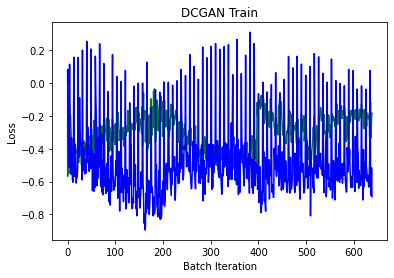

Epoch 72/100 :
     Batch 1/9 generator loss | discriminator loss : -0.18033277988433838 | -0.6952616423368454 - batch took 7.3681640625 s.
     Batch 2/9 generator loss | discriminator loss : -0.4123208820819855 | -0.7368194311857224 - batch took 6.479774713516235 s.
     Batch 3/9 generator loss | discriminator loss : -0.13167083263397217 | -0.5149731934070587 - batch took 6.723191976547241 s.
     Batch 4/9 generator loss | discriminator loss : -0.3335891664028168 | -0.5986244082450867 - batch took 7.186895847320557 s.


<Figure size 432x288 with 0 Axes>

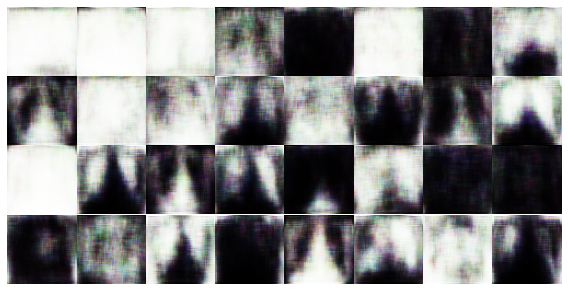

     Batch 5/9 generator loss | discriminator loss : -0.2564935088157654 | 0.07113859057426453 - batch took 8.083139657974243 s.
     Batch 6/9 generator loss | discriminator loss : -0.4100310206413269 | -0.7089255750179291 - batch took 7.4977052211761475 s.
     Batch 7/9 generator loss | discriminator loss : -0.2547817826271057 | -0.6544017195701599 - batch took 5.847039222717285 s.
     Batch 8/9 generator loss | discriminator loss : -0.27158987522125244 | -0.7305689454078674 - batch took 7.185445547103882 s.
     Batch 9/9 generator loss | discriminator loss : -0.25657394528388977 | -0.6920666545629501 - batch took 8.330990076065063 s.


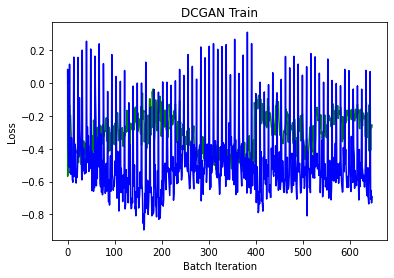

Epoch 73/100 :
     Batch 1/9 generator loss | discriminator loss : -0.33727964758872986 | -0.6487216949462891 - batch took 7.001990079879761 s.
     Batch 2/9 generator loss | discriminator loss : -0.08929301053285599 | -0.4548181891441345 - batch took 7.211673259735107 s.
     Batch 3/9 generator loss | discriminator loss : -0.28805261850357056 | -0.7332102060317993 - batch took 7.813392400741577 s.
     Batch 4/9 generator loss | discriminator loss : -0.2530508041381836 | -0.5833237171173096 - batch took 6.803484678268433 s.


<Figure size 432x288 with 0 Axes>

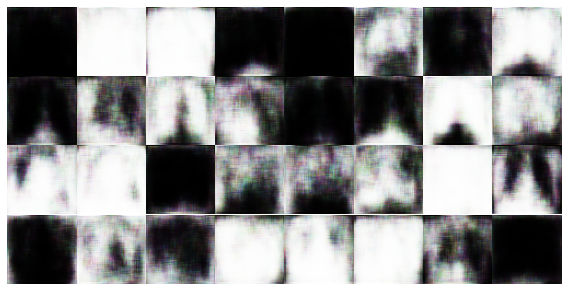

     Batch 5/9 generator loss | discriminator loss : -0.11637846380472183 | -0.007496386766433716 - batch took 8.866862773895264 s.
     Batch 6/9 generator loss | discriminator loss : -0.09563353657722473 | -0.7879223227500916 - batch took 7.9224114418029785 s.
     Batch 7/9 generator loss | discriminator loss : -0.2670365571975708 | -0.6883151531219482 - batch took 7.268806457519531 s.
     Batch 8/9 generator loss | discriminator loss : -0.3032648265361786 | -0.6730510592460632 - batch took 7.028340816497803 s.
     Batch 9/9 generator loss | discriminator loss : -0.06327426433563232 | -0.6099594831466675 - batch took 7.113429307937622 s.


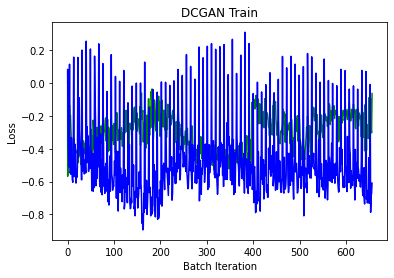

Epoch 74/100 :
     Batch 1/9 generator loss | discriminator loss : -0.09488794207572937 | -0.8620614260435104 - batch took 6.98113751411438 s.
     Batch 2/9 generator loss | discriminator loss : -0.07940717041492462 | -0.7430099695920944 - batch took 6.763145685195923 s.
     Batch 3/9 generator loss | discriminator loss : -0.10614968836307526 | -0.6291024386882782 - batch took 7.141153335571289 s.
     Batch 4/9 generator loss | discriminator loss : -0.3328191936016083 | -0.7200528681278229 - batch took 6.524974346160889 s.


<Figure size 432x288 with 0 Axes>

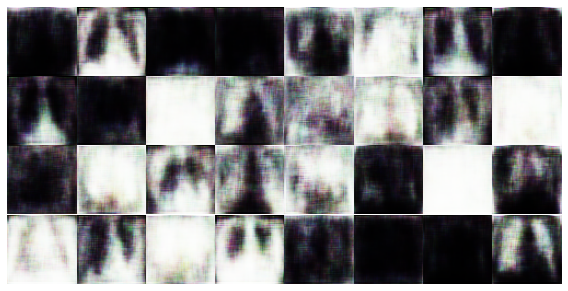

     Batch 5/9 generator loss | discriminator loss : -0.07330535352230072 | 0.12335449457168579 - batch took 8.462656497955322 s.
     Batch 6/9 generator loss | discriminator loss : -0.0429568812251091 | -0.7786387801170349 - batch took 6.135653734207153 s.
     Batch 7/9 generator loss | discriminator loss : -0.0952099934220314 | -0.8103513717651367 - batch took 7.1501123905181885 s.
     Batch 8/9 generator loss | discriminator loss : -0.2042676955461502 | -0.8169025182723999 - batch took 8.29729676246643 s.
     Batch 9/9 generator loss | discriminator loss : -0.18927285075187683 | -0.7293601632118225 - batch took 6.728280305862427 s.


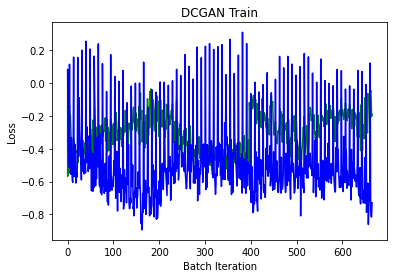

Epoch 75/100 :
     Batch 1/9 generator loss | discriminator loss : -0.2378479540348053 | -0.5421186685562134 - batch took 7.623361349105835 s.
     Batch 2/9 generator loss | discriminator loss : -0.21178027987480164 | -0.6204542517662048 - batch took 7.636465072631836 s.
     Batch 3/9 generator loss | discriminator loss : -0.196680948138237 | -0.5871732532978058 - batch took 7.412021160125732 s.
     Batch 4/9 generator loss | discriminator loss : -0.23705677688121796 | -0.5717804133892059 - batch took 7.3488616943359375 s.


<Figure size 432x288 with 0 Axes>

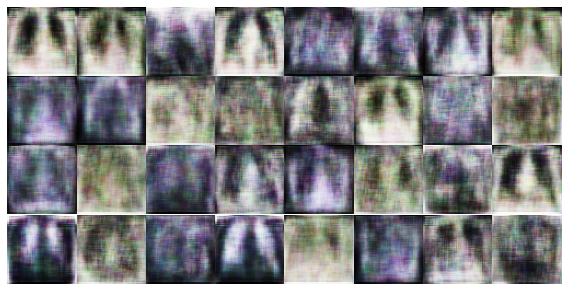

     Batch 5/9 generator loss | discriminator loss : -0.18157356977462769 | 0.0792008489370346 - batch took 9.745121955871582 s.
     Batch 6/9 generator loss | discriminator loss : -0.1738436222076416 | -0.32505786418914795 - batch took 7.074530601501465 s.
     Batch 7/9 generator loss | discriminator loss : -0.19096219539642334 | -0.6168850660324097 - batch took 7.52067494392395 s.
     Batch 8/9 generator loss | discriminator loss : -0.1651397943496704 | -0.510785311460495 - batch took 7.170028448104858 s.
     Batch 9/9 generator loss | discriminator loss : -0.15253865718841553 | -0.43481695652008057 - batch took 6.776152610778809 s.


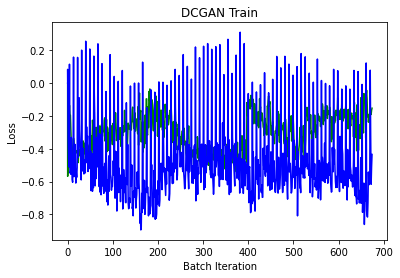

Epoch 76/100 :
     Batch 1/9 generator loss | discriminator loss : -0.1332140415906906 | -0.6030045747756958 - batch took 7.063867092132568 s.
     Batch 2/9 generator loss | discriminator loss : -0.3180030584335327 | -0.6139431297779083 - batch took 7.583308219909668 s.
     Batch 3/9 generator loss | discriminator loss : -0.26440146565437317 | -0.49622413516044617 - batch took 6.541220664978027 s.
     Batch 4/9 generator loss | discriminator loss : -0.254116952419281 | -0.5748609900474548 - batch took 7.188368558883667 s.
     Batch 5/9 generator loss | discriminator loss : -0.19197393953800201 | 0.010953724384307861 - batch took 5.811495780944824 s.
     Batch 6/9 generator loss | discriminator loss : -0.20884756743907928 | -0.5676828622817993 - batch took 7.164940595626831 s.
     Batch 7/9 generator loss | discriminator loss : -0.2758651375770569 | -0.4550490975379944 - batch took 8.298348188400269 s.
     Batch 8/9 generator loss | discriminator loss : -0.1900671422481537 | -0.

<Figure size 432x288 with 0 Axes>

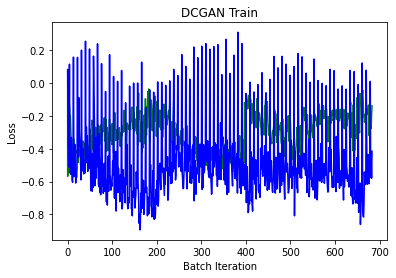

Epoch 77/100 :
     Batch 1/9 generator loss | discriminator loss : -0.18892425298690796 | -0.5586419701576233 - batch took 8.234048843383789 s.
     Batch 2/9 generator loss | discriminator loss : -0.2648461163043976 | -0.5407484769821167 - batch took 6.768046617507935 s.
     Batch 3/9 generator loss | discriminator loss : -0.2462463676929474 | -0.4634394347667694 - batch took 7.390311002731323 s.
     Batch 4/9 generator loss | discriminator loss : -0.25958389043807983 | -0.7593954205513 - batch took 7.694601058959961 s.


<Figure size 432x288 with 0 Axes>

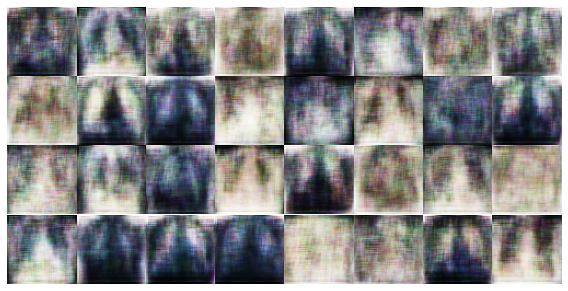

     Batch 5/9 generator loss | discriminator loss : -0.22336289286613464 | 0.0653458833694458 - batch took 8.508925676345825 s.
     Batch 6/9 generator loss | discriminator loss : -0.21662726998329163 | -0.4401973485946655 - batch took 7.508974313735962 s.
     Batch 7/9 generator loss | discriminator loss : -0.18079708516597748 | -0.6042079627513885 - batch took 7.1071391105651855 s.
     Batch 8/9 generator loss | discriminator loss : -0.21589002013206482 | -0.7427403777837753 - batch took 6.511670112609863 s.
     Batch 9/9 generator loss | discriminator loss : -0.1730346381664276 | -0.5886170268058777 - batch took 6.785184144973755 s.


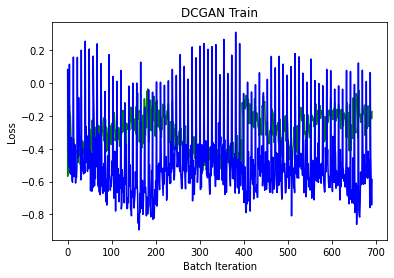

Epoch 78/100 :
     Batch 1/9 generator loss | discriminator loss : -0.23394401371479034 | -0.4240398406982422 - batch took 7.437047004699707 s.
     Batch 2/9 generator loss | discriminator loss : -0.24283891916275024 | -0.4679069221019745 - batch took 6.545038461685181 s.
     Batch 3/9 generator loss | discriminator loss : -0.2170725017786026 | -0.5605718493461609 - batch took 7.200096368789673 s.
     Batch 4/9 generator loss | discriminator loss : -0.2461499720811844 | -0.6176241636276245 - batch took 5.801971197128296 s.


<Figure size 432x288 with 0 Axes>

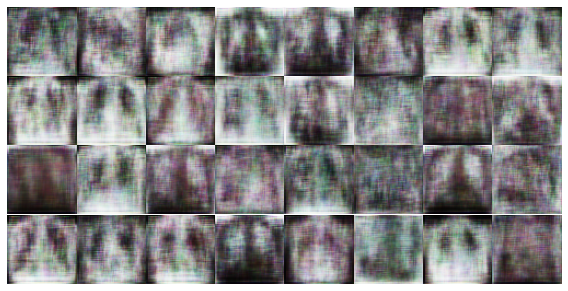

     Batch 5/9 generator loss | discriminator loss : -0.12867021560668945 | 0.03804302215576172 - batch took 8.412545204162598 s.
     Batch 6/9 generator loss | discriminator loss : -0.14505384862422943 | -0.3498116135597229 - batch took 8.598474502563477 s.
     Batch 7/9 generator loss | discriminator loss : -0.18180018663406372 | -0.5459780097007751 - batch took 6.729576587677002 s.
     Batch 8/9 generator loss | discriminator loss : -0.22173359990119934 | -0.6391240954399109 - batch took 7.270092010498047 s.
     Batch 9/9 generator loss | discriminator loss : -0.23552697896957397 | -0.6495886445045471 - batch took 7.790614128112793 s.


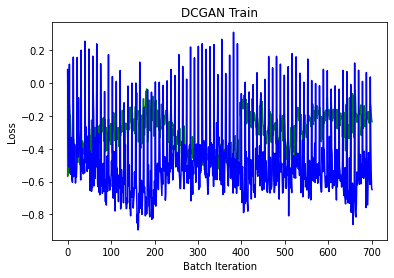

Epoch 79/100 :
     Batch 1/9 generator loss | discriminator loss : -0.15072962641716003 | -0.6316128224134445 - batch took 7.208166599273682 s.
     Batch 2/9 generator loss | discriminator loss : -0.2557545602321625 | -0.4447740316390991 - batch took 7.3903820514678955 s.
     Batch 3/9 generator loss | discriminator loss : -0.24815626442432404 | -0.5676175057888031 - batch took 7.707507610321045 s.
     Batch 4/9 generator loss | discriminator loss : -0.23513023555278778 | -0.3721194863319397 - batch took 7.223266124725342 s.


<Figure size 432x288 with 0 Axes>

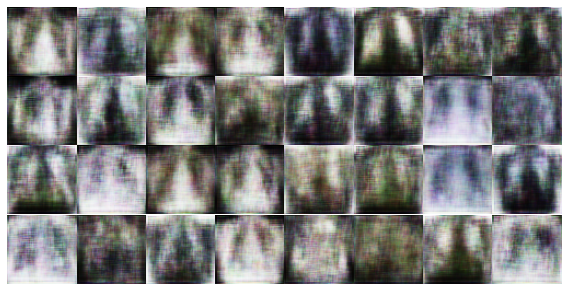

     Batch 5/9 generator loss | discriminator loss : -0.14944282174110413 | -0.0016164332628250122 - batch took 8.592616558074951 s.
     Batch 6/9 generator loss | discriminator loss : -0.1314900815486908 | -0.6467166543006897 - batch took 7.342763662338257 s.
     Batch 7/9 generator loss | discriminator loss : -0.13639026880264282 | -0.45496800541877747 - batch took 6.529205799102783 s.
     Batch 8/9 generator loss | discriminator loss : -0.12693563103675842 | -0.6160267293453217 - batch took 6.746644020080566 s.
     Batch 9/9 generator loss | discriminator loss : -0.11331326514482498 | -0.5039928257465363 - batch took 7.22310209274292 s.


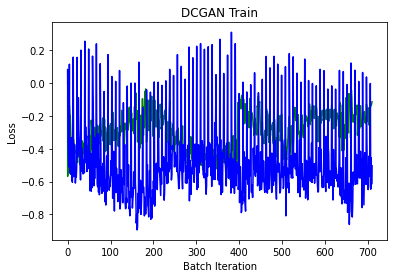

Epoch 80/100 :
     Batch 1/9 generator loss | discriminator loss : -0.24855339527130127 | -0.4715007245540619 - batch took 6.914320945739746 s.
     Batch 2/9 generator loss | discriminator loss : -0.10933537781238556 | -0.6766722798347473 - batch took 7.095487117767334 s.
     Batch 3/9 generator loss | discriminator loss : -0.17787224054336548 | -0.7120490223169327 - batch took 7.433159828186035 s.
     Batch 4/9 generator loss | discriminator loss : -0.11449139565229416 | -0.6726223826408386 - batch took 7.092295408248901 s.


<Figure size 432x288 with 0 Axes>

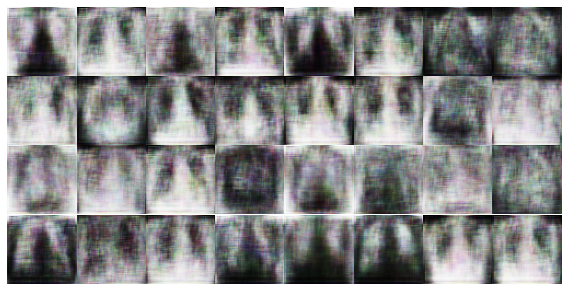

     Batch 5/9 generator loss | discriminator loss : -0.10237906128168106 | -0.0077318549156188965 - batch took 10.282322883605957 s.
     Batch 6/9 generator loss | discriminator loss : -0.12069534510374069 | -0.5587253421545029 - batch took 6.87054705619812 s.
     Batch 7/9 generator loss | discriminator loss : -0.20660914480686188 | -0.4530305862426758 - batch took 7.5102972984313965 s.
     Batch 8/9 generator loss | discriminator loss : -0.18916486203670502 | -0.564170241355896 - batch took 8.070872783660889 s.
     Batch 9/9 generator loss | discriminator loss : -0.15009066462516785 | -0.4512261152267456 - batch took 6.969566822052002 s.


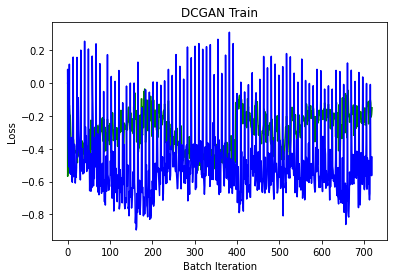

Epoch 81/100 :
     Batch 1/9 generator loss | discriminator loss : -0.16111814975738525 | -0.484845906496048 - batch took 8.103804588317871 s.
     Batch 2/9 generator loss | discriminator loss : -0.19049671292304993 | -0.579542338848114 - batch took 7.73523211479187 s.
     Batch 3/9 generator loss | discriminator loss : -0.17202754318714142 | -0.573532223701477 - batch took 7.2181007862091064 s.
     Batch 4/9 generator loss | discriminator loss : -0.1809443235397339 | -0.6989594995975494 - batch took 7.063161611557007 s.


<Figure size 432x288 with 0 Axes>

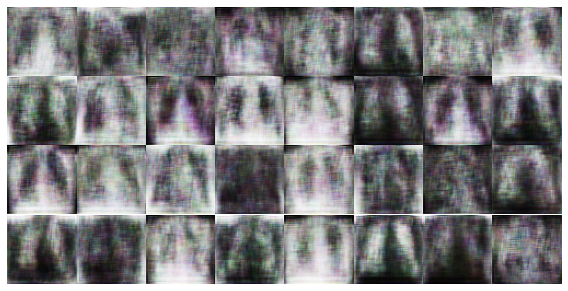

     Batch 5/9 generator loss | discriminator loss : -0.1350860297679901 | 0.004013746976852417 - batch took 8.477883100509644 s.
     Batch 6/9 generator loss | discriminator loss : -0.10502102971076965 | -0.47007322311401367 - batch took 6.834951877593994 s.
     Batch 7/9 generator loss | discriminator loss : -0.1283697783946991 | -0.6520041972398758 - batch took 6.778390645980835 s.
     Batch 8/9 generator loss | discriminator loss : -0.12035664916038513 | -0.4699939489364624 - batch took 7.188263654708862 s.
     Batch 9/9 generator loss | discriminator loss : -0.2424555867910385 | -0.49963390827178955 - batch took 6.585139751434326 s.


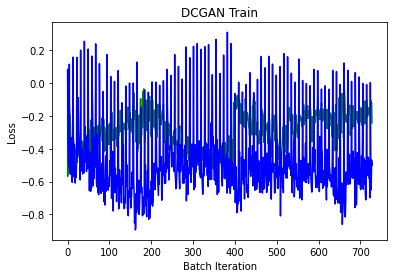

Epoch 82/100 :
     Batch 1/9 generator loss | discriminator loss : -0.08897902071475983 | -0.583655834197998 - batch took 7.637685537338257 s.
     Batch 2/9 generator loss | discriminator loss : -0.10036515444517136 | -0.6379218101501465 - batch took 5.843242645263672 s.
     Batch 3/9 generator loss | discriminator loss : -0.19830718636512756 | -0.6794760674238205 - batch took 7.199011564254761 s.
     Batch 4/9 generator loss | discriminator loss : -0.16884899139404297 | -0.619297057390213 - batch took 8.409892559051514 s.


<Figure size 432x288 with 0 Axes>

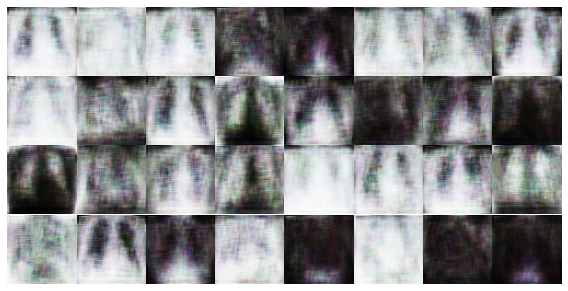

     Batch 5/9 generator loss | discriminator loss : -0.1412670910358429 | -0.02588486671447754 - batch took 8.27728009223938 s.
     Batch 6/9 generator loss | discriminator loss : -0.22791709005832672 | -0.5374477505683899 - batch took 7.495092153549194 s.
     Batch 7/9 generator loss | discriminator loss : -0.1520107388496399 | -0.6849101781845093 - batch took 7.805085897445679 s.
     Batch 8/9 generator loss | discriminator loss : -0.2844562530517578 | -0.6270114183425903 - batch took 6.803913831710815 s.
     Batch 9/9 generator loss | discriminator loss : -0.4028133749961853 | -0.6550388634204865 - batch took 7.421752452850342 s.


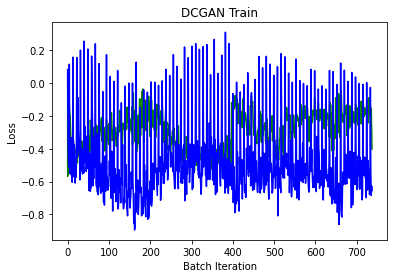

Epoch 83/100 :
     Batch 1/9 generator loss | discriminator loss : -0.07536044716835022 | -0.5541648864746094 - batch took 8.045390844345093 s.
     Batch 2/9 generator loss | discriminator loss : -0.31586769223213196 | -0.6915369629859924 - batch took 7.212091684341431 s.
     Batch 3/9 generator loss | discriminator loss : -0.24241520464420319 | -0.590458869934082 - batch took 7.060774564743042 s.
     Batch 4/9 generator loss | discriminator loss : -0.30893224477767944 | -0.41052424907684326 - batch took 7.178729057312012 s.


<Figure size 432x288 with 0 Axes>

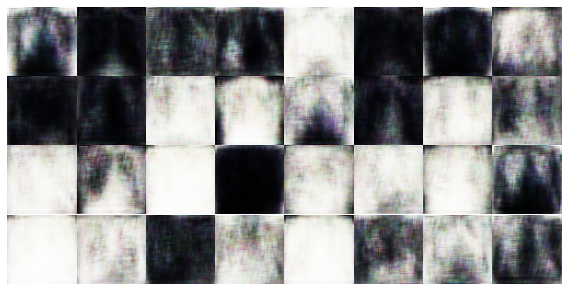

     Batch 5/9 generator loss | discriminator loss : -0.1704873889684677 | 0.10611715912818909 - batch took 8.033915042877197 s.
     Batch 6/9 generator loss | discriminator loss : -0.2769230306148529 | -0.7471327185630798 - batch took 6.988995552062988 s.
     Batch 7/9 generator loss | discriminator loss : -0.16782930493354797 | -0.4897867441177368 - batch took 7.20706582069397 s.
     Batch 8/9 generator loss | discriminator loss : -0.3610324263572693 | -0.6581611335277557 - batch took 6.530629873275757 s.
     Batch 9/9 generator loss | discriminator loss : -0.4136143624782562 | -0.6074635684490204 - batch took 7.212396144866943 s.


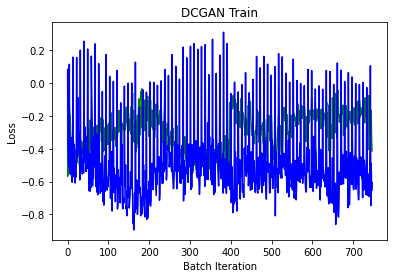

Epoch 84/100 :
     Batch 1/9 generator loss | discriminator loss : -0.10923829674720764 | -0.45414215326309204 - batch took 6.213321924209595 s.
     Batch 2/9 generator loss | discriminator loss : -0.12157130241394043 | -0.8128987401723862 - batch took 7.203347682952881 s.
     Batch 3/9 generator loss | discriminator loss : -0.13350245356559753 | -0.7837617993354797 - batch took 8.348013877868652 s.
     Batch 4/9 generator loss | discriminator loss : -0.27904051542282104 | -0.7478386461734772 - batch took 6.718985319137573 s.


<Figure size 432x288 with 0 Axes>

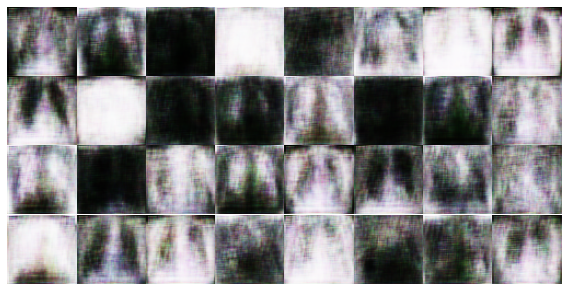

     Batch 5/9 generator loss | discriminator loss : -0.07275883108377457 | 0.0940302163362503 - batch took 8.550317764282227 s.
     Batch 6/9 generator loss | discriminator loss : -0.31641635298728943 | -0.6862780600786209 - batch took 8.083426237106323 s.
     Batch 7/9 generator loss | discriminator loss : -0.2013130635023117 | -0.5173100233078003 - batch took 6.896559715270996 s.
     Batch 8/9 generator loss | discriminator loss : -0.21286749839782715 | -0.6209604144096375 - batch took 7.426764965057373 s.
     Batch 9/9 generator loss | discriminator loss : -0.18989244103431702 | -0.6832078099250793 - batch took 7.697571039199829 s.


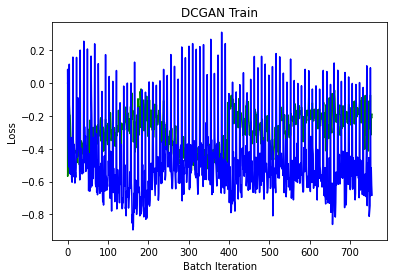

Epoch 85/100 :
     Batch 1/9 generator loss | discriminator loss : -0.24543626606464386 | -0.6675049364566803 - batch took 7.547987222671509 s.
     Batch 2/9 generator loss | discriminator loss : -0.14720533788204193 | -0.6312218010425568 - batch took 6.906973838806152 s.
     Batch 3/9 generator loss | discriminator loss : -0.18136031925678253 | -0.6724298596382141 - batch took 7.525529623031616 s.
     Batch 4/9 generator loss | discriminator loss : -0.15373077988624573 | -0.6733312606811523 - batch took 6.763271331787109 s.


<Figure size 432x288 with 0 Axes>

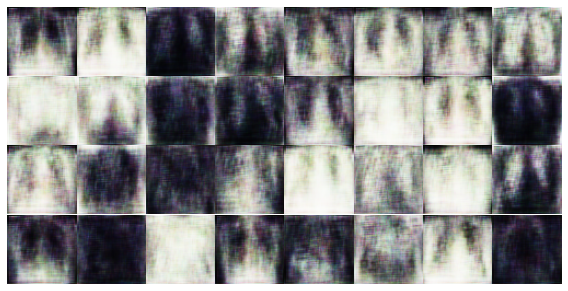

     Batch 5/9 generator loss | discriminator loss : -0.10632623732089996 | -0.03159797191619873 - batch took 8.610378742218018 s.
     Batch 6/9 generator loss | discriminator loss : -0.1727575659751892 | -0.4816772788763046 - batch took 7.003985166549683 s.
     Batch 7/9 generator loss | discriminator loss : -0.24218791723251343 | -0.47564855217933655 - batch took 6.994823455810547 s.
     Batch 8/9 generator loss | discriminator loss : -0.23079438507556915 | -0.6953568756580353 - batch took 7.235673666000366 s.
     Batch 9/9 generator loss | discriminator loss : -0.0987372025847435 | -0.8020060658454895 - batch took 5.832615613937378 s.


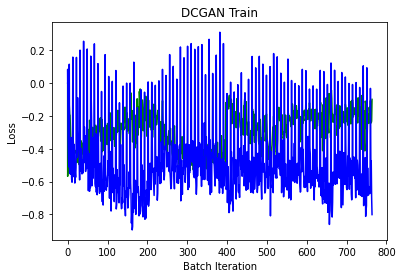

Epoch 86/100 :
     Batch 1/9 generator loss | discriminator loss : -0.10188707709312439 | -0.6197728514671326 - batch took 7.813780307769775 s.
     Batch 2/9 generator loss | discriminator loss : -0.21216103434562683 | -0.5763213038444519 - batch took 8.30963397026062 s.
     Batch 3/9 generator loss | discriminator loss : -0.18833211064338684 | -0.6879715919494629 - batch took 6.7676355838775635 s.
     Batch 4/9 generator loss | discriminator loss : -0.21229831874370575 | -0.426371306180954 - batch took 7.251957178115845 s.


<Figure size 432x288 with 0 Axes>

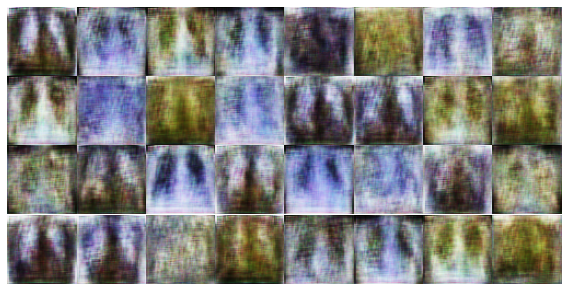

     Batch 5/9 generator loss | discriminator loss : -0.04669398069381714 | -0.10408975183963776 - batch took 9.297590017318726 s.
     Batch 6/9 generator loss | discriminator loss : -0.07840685546398163 | -0.5715596079826355 - batch took 7.171767473220825 s.
     Batch 7/9 generator loss | discriminator loss : -0.17321860790252686 | -0.5134419202804565 - batch took 7.465052127838135 s.
     Batch 8/9 generator loss | discriminator loss : -0.18259158730506897 | -0.4908008575439453 - batch took 7.720598459243774 s.
     Batch 9/9 generator loss | discriminator loss : -0.13345380127429962 | -0.5353978872299194 - batch took 7.239023447036743 s.


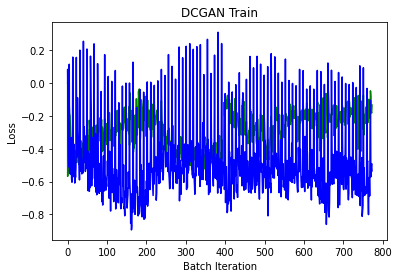

Epoch 87/100 :
     Batch 1/9 generator loss | discriminator loss : -0.12352265417575836 | -0.7708529233932495 - batch took 7.281266927719116 s.
     Batch 2/9 generator loss | discriminator loss : -0.22490130364894867 | -0.6340931355953217 - batch took 7.224858283996582 s.
     Batch 3/9 generator loss | discriminator loss : -0.22286410629749298 | -0.6413954496383667 - batch took 6.510409593582153 s.
     Batch 4/9 generator loss | discriminator loss : -0.1867925524711609 | -0.7579913139343262 - batch took 6.813326120376587 s.


<Figure size 432x288 with 0 Axes>

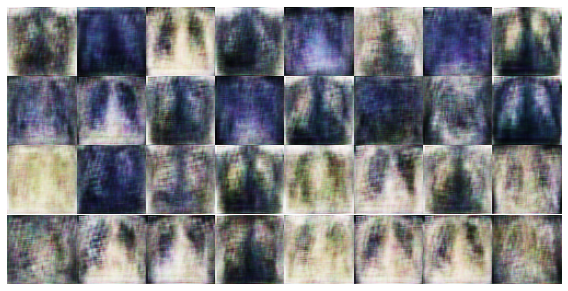

     Batch 5/9 generator loss | discriminator loss : -0.10863560438156128 | -0.003311634063720703 - batch took 8.477651119232178 s.
     Batch 6/9 generator loss | discriminator loss : -0.17436471581459045 | -0.34795093536376953 - batch took 6.841562271118164 s.
     Batch 7/9 generator loss | discriminator loss : -0.24763712286949158 | -0.5659236907958984 - batch took 7.280923843383789 s.
     Batch 8/9 generator loss | discriminator loss : -0.2592649459838867 | -0.5359910726547241 - batch took 5.8791117668151855 s.
     Batch 9/9 generator loss | discriminator loss : -0.16152238845825195 | -0.5690567791461945 - batch took 7.133023500442505 s.


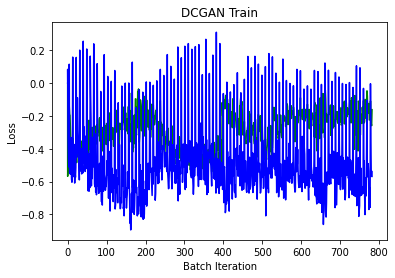

Epoch 88/100 :
     Batch 1/9 generator loss | discriminator loss : -0.22272801399230957 | -0.4575422406196594 - batch took 8.755798578262329 s.
     Batch 2/9 generator loss | discriminator loss : -0.12396460771560669 | -0.6745337694883347 - batch took 6.744444131851196 s.
     Batch 3/9 generator loss | discriminator loss : -0.26725146174430847 | -0.6218243837356567 - batch took 7.232381582260132 s.


In [ ]:
plt.ion()

current_batch = 0
number_of_batches = int(586/64)
    # Let's train the DCGAN for n epochs
epochs = 100
for epoch in range(epochs):
  print("Epoch " + str(epoch+1) + "/" + str(epochs) + " :")
  for batch_number in range(number_of_batches):
    start_time = time.time()
          # Get the current batch and normalize the images between -1 and 1
    real_images = next(train_generator)
    real_images = np.array(real_images)
    real_images /= 127.5
    real_images -= 1

            # The last batch is smaller than the other ones, so we need to
            # take that into account
    current_batch_size = real_images.shape[0]

            # Generate noise
    noise = np.random.uniform(-1.0, 1.0, size=(current_batch_size,100) )

            # Generate images
    generated_images = generator.predict(noise)
    fake_y = np.ones(current_batch_size ) 
    real_y  = -np.ones(current_batch_size ) 

    if (batch_number + 1) % 5 ==0:
      fake_y *= 0.8
      real_y *= 0.2

    discriminator.trainable = True

    d_loss = discriminator.train_on_batch(real_images, real_y)
    d_loss += discriminator.train_on_batch(generated_images, fake_y)

    discriminator_loss = np.append(discriminator_loss, d_loss)

    discriminator.trainable = False


    #         # We try to mislead the discriminator by giving the opposite labels
    # fake_y = (np.ones(current_batch_size * 2) -
    #                   np.random.random_sample(current_batch_size * 2) * 0.2)

    noise = np.random.uniform(-1.0, 1.0, size=(current_batch_size,100) )
    real_y  = -np.ones(current_batch_size)

    g_loss = gan.train_on_batch(noise, real_y)

    adversarial_loss = np.append(adversarial_loss, g_loss)
    batches = np.append(batches, current_batch)

            # Each 50 batches show and save images
    if ((batch_number + 1) % 5 == 0 and current_batch_size == BATCH_SIZE):
      save_generated_images(generated_images, epoch, batch_number)

    time_elapsed = time.time() - start_time

            # Display and plot the results
    print("     Batch " + str(batch_number + 1) + "/" +
                  str(number_of_batches) +
                  " generator loss | discriminator loss : " +
                  str(g_loss) + " | " + str(d_loss) + ' - batch took ' +
                  str(time_elapsed) + ' s.')

    current_batch += 1

        # Save the model weights each 5 epochs
    if (epoch + 1) % 5 == 0:
        # discriminator.trainable = Truereal_y  = np.zeros(current_batch_size)
        generator.save(data_dir + 'wgenerator_epoch2.hdf5')
        discriminator.save(data_dir + 'wdiscriminator_epoch2.hdf5') 

        # Each epoch update the loss graphs
        
  plt.figure(2)
  plt.plot(batches, adversarial_loss, color='green',
                 label='Generator Loss')
  plt.plot(batches, discriminator_loss, color='blue',
                 label='Discriminator Loss')
  plt.title("DCGAN Train")
  plt.xlabel("Batch Iteration")
  plt.ylabel("Loss")
  if epoch == 0:
      plt.legend()
  plt.pause(0.0000000001)
  plt.show()
  plt.savefig('trainingLossPlot.png')

In [ ]:
meta_data=pd.read_csv(new_meta_dir+'metadata_processed.csv')
meta_data.glename':'count'})

In [ ]:
from keras.preprocessing.image import ImageDataGenerator,load_img, img_to_array
from sklearn.model_selection import train_test_split

# meta_data = meta_data[meta_data['finding']=='COVID-19']

x_train, x_test, y_train , y_test = train_test_split(meta_data, meta_data['finding'], random_state=42)
# x_train=meta_data
print(x_train.groupby(['finding']).agg({'filename':'count'}))

IMG_H, IMG_W = 64,64
BATCH_SIZE = 64
image_shape = (64,64,3)
epochs=200

In [ ]:
import cv2

needed = 4577-439

for i in range(needed):
  noise = np.random.uniform(-1.0, 1.0, size=(1,100) )
  img = generator.predict(noise)
  fn='xx_'+str(i)+'.jpg'
  cv2.imwrite(new_dir+fn,img[0,:,:,:]*255)
  x_train=x_train.append(pd.DataFrame({'filename':[fn], 'finding': ['COVID-19']}))

# x = np.array(noise).reshape(-1, 64, 64, 3)
# y = [[0]*2]*needed
# y[0][0]=1
# y = np.array(y)
# print(y.shape)


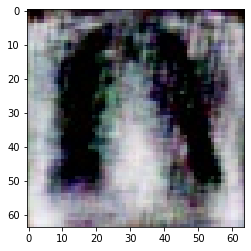

In [ ]:
x_train.to_csv(new_meta_dir+'x_train.csv')
y_train.to_csv(new_meta_dir+'y_train.csv')
x_test.to_csv(new_meta_dir+'x_test.csv')
y_test.to_csv(new_meta_dir+'y_test.csv')
# plt.imshow(img[0,:,:,:])
image = cv2.imread(new_dir+fn)
plt.imshow(image)
plt.show()